# 1. Data Understanding and Preprocessing

First few rows of the dataset:
                               time  latitude  longitude  depth   mag magType  \
0  1950-01-02 15:14:37.960000+00:00   -11.242    165.006   15.0  6.12      mw   
1  1950-01-03 02:51:55.410000+00:00    17.533    121.447   30.0  6.50      mw   
2  1950-01-03 11:06:28.640000+00:00   -45.798    -77.077   15.0  6.27      mw   
3  1950-01-10 03:05:40.370000+00:00    10.031   -103.964   15.0  6.10      mw   
4         1950-01-14 19:52:30+00:00    40.217   -124.417    NaN  4.60      ml   

   nst  gap  dmin  rms  ... magType_mlr magType_ms magType_ms_20 magType_mw  \
0  NaN  NaN   NaN  NaN  ...           0          0             0          1   
1  NaN  NaN   NaN  NaN  ...           0          0             0          1   
2  NaN  NaN   NaN  NaN  ...           0          0             0          1   
3  NaN  NaN   NaN  NaN  ...           0          0             0          1   
4  NaN  NaN   NaN  NaN  ...           0          0             0          0   

  magTy

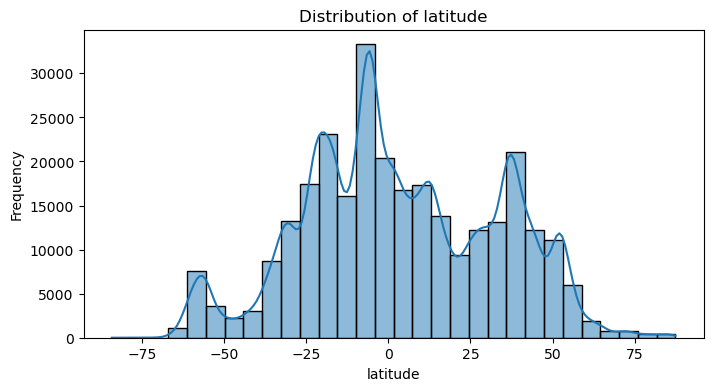

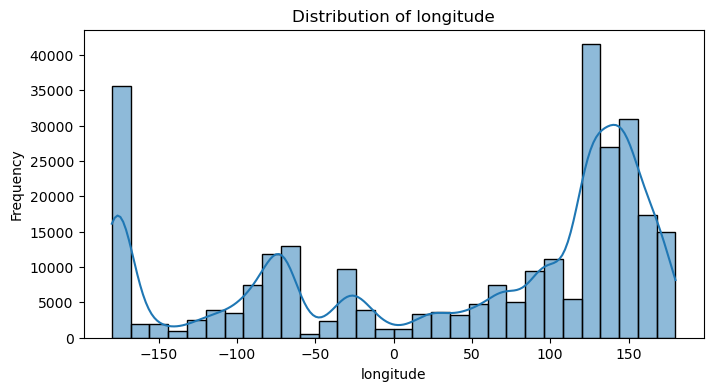

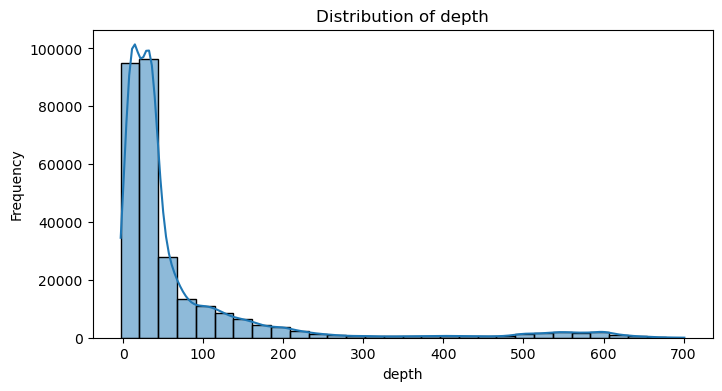

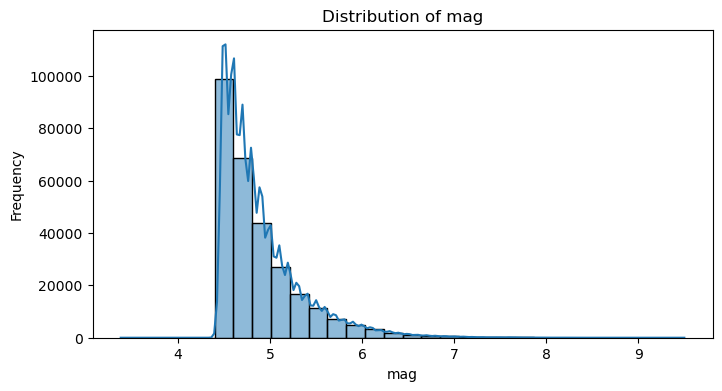


Possible anomalies in 'mag' column (values outside typical earthquake magnitude range 0-10):
Empty DataFrame
Columns: [time, latitude, longitude, depth, mag, magType, nst, gap, dmin, rms, net, id, updated, place, type, horizontalError, depthError, magError, magNst, status, locationSource, magSource, date, time_only, year, month, magType_numeric, magType_fa, magType_lg, magType_m, magType_ma, magType_mb, magType_mb_lg, magType_mblg, magType_mc, magType_md, magType_mh, magType_ml, magType_ml(texnet), magType_mlg, magType_mlr, magType_ms, magType_ms_20, magType_mw, magType_mwb, magType_mwc, magType_mwp, magType_mwr, magType_mww, magType_uk]
Index: []

[0 rows x 50 columns]

Possible anomalies in 'depth' column (negative values):
                                    time   latitude   longitude  depth   mag  \
3434    1960-12-25 12:56:28.010000+00:00  19.203167 -155.706500 -1.059  4.60   
4258    1963-10-23 20:24:06.180000+00:00  19.387167 -155.429167 -0.782  5.53   
15140   1974-11-30 13:5

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = 'processed_data magType.csv'
df = pd.read_csv(file_path)

# Display the first few rows of the dataset
print("First few rows of the dataset:")
print(df.head())

# Display the structure of the dataset
print("\nDataset Info:")
print(df.info())

# Summary statistics for numerical columns
print("\nSummary Statistics:")
print(df.describe())

# Check for missing values
print("\nMissing Values:")
print(df.isnull().sum())

# Visualize the distribution of key numerical features
numerical_features = ['latitude', 'longitude', 'depth', 'mag']  # Adjust features as necessary
for feature in numerical_features:
    if feature in df.columns:
        plt.figure(figsize=(8, 4))
        sns.histplot(df[feature], kde=True, bins=30)
        plt.title(f'Distribution of {feature}')
        plt.xlabel(feature)
        plt.ylabel('Frequency')
        plt.show()

# Check for anomalies in magnitude (mag) and depth
if 'mag' in df.columns:
    print("\nPossible anomalies in 'mag' column (values outside typical earthquake magnitude range 0-10):")
    print(df[(df['mag'] < 0) | (df['mag'] > 10)])

if 'depth' in df.columns:
    print("\nPossible anomalies in 'depth' column (negative values):")
    print(df[df['depth'] < 0])


# Data Cleaning

In [18]:
import pandas as pd
import numpy as np
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Load the dataset
file_path = 'processed_data magType.csv'
df = pd.read_csv(file_path)

# Impute depth using regional averages based on latitude, longitude, and magType
if 'depth' in df.columns:
    df['depth'] = df.groupby(['latitude', 'longitude', 'magType'])['depth'].transform(
        lambda x: x.fillna(x.mean())
    )

# Fallback: Impute remaining depth values using overall mean
df['depth'].fillna(df['depth'].mean(), inplace=True)

# Impute RMS using averages grouped by event type
if 'rms' in df.columns and 'type' in df.columns:
    df['rms'] = df.groupby('type')['rms'].transform(lambda x: x.fillna(x.mean()))

# Fallback: Impute remaining RMS values using overall mean
df['rms'].fillna(df['rms'].mean(), inplace=True)

# Drop irrelevant columns
irrelevant_columns = ['id', 'status', 'net']
df.drop(columns=irrelevant_columns, inplace=True)

# Remove duplicate entries
df.drop_duplicates(inplace=True)

# Handle outliers in geospatial data
df = df[(df['latitude'].between(-90, 90)) & (df['longitude'].between(-180, 180))]

print("Done")


Done


# Feature Engineering

In [37]:
import pandas as pd
import numpy as np

# Temporal Features
try:
    df['time'] = pd.to_datetime(df['time'], format='ISO8601', errors='coerce')  # Ensure robust parsing
    df['year'] = df['time'].dt.year
    df['month'] = df['time'].dt.month
    df['day'] = df['time'].dt.day
    df['hour'] = df['time'].dt.hour
except Exception as e:
    print(f"Error in datetime conversion: {e}")

# Define seasons
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Autumn'

if 'month' in df.columns:
    df['season'] = df['month'].apply(get_season)

# Encoding magType using one-hot encoding
if 'magType' in df.columns:
    df_encoded = pd.get_dummies(df['magType'], prefix='magType')
    df = pd.concat([df, df_encoded], axis=1)
    df.drop(columns=['magType'], inplace=True)

# Error Metrics: Create combined error metrics
if 'horizontalError' in df.columns and 'depthError' in df.columns:
    df['combinedError'] = df[['horizontalError', 'depthError']].mean(axis=1, skipna=True)

# Geospatial Feature: Proximity to tectonic plate boundaries (mock example)
def calculate_proximity(lat, lon, boundary_lat, boundary_lon):
    """Calculate approximate distance from a point to a tectonic plate boundary."""
    return np.sqrt((lat - boundary_lat)**2 + (lon - boundary_lon)**2)  # Placeholder, not real distance

# Example tectonic boundary coordinates (replace with real data if available)
tectonic_boundary_lat, tectonic_boundary_lon = 10.0, 20.0

if 'latitude' in df.columns and 'longitude' in df.columns:
    df['proximity_to_boundary'] = df.apply(
        lambda row: calculate_proximity(
            row['latitude'], row['longitude'], tectonic_boundary_lat, tectonic_boundary_lon
        ),
        axis=1
    )
print("Done")

Done


# Data Normalization/Scaling

In [38]:
# Scale numerical features
numerical_features = ['latitude', 'longitude', 'depth', 'mag', 'rms']

# Standardization (Z-score scaling)
scaler = StandardScaler()
df[numerical_features] = scaler.fit_transform(df[numerical_features])

# Or Min-Max Scaling
# scaler = MinMaxScaler()
# df[numerical_features] = scaler.fit_transform(df[numerical_features])
print("Done")

Done


# 2. Exploratory Data Analysis (EDA)

# Visualizing Trends

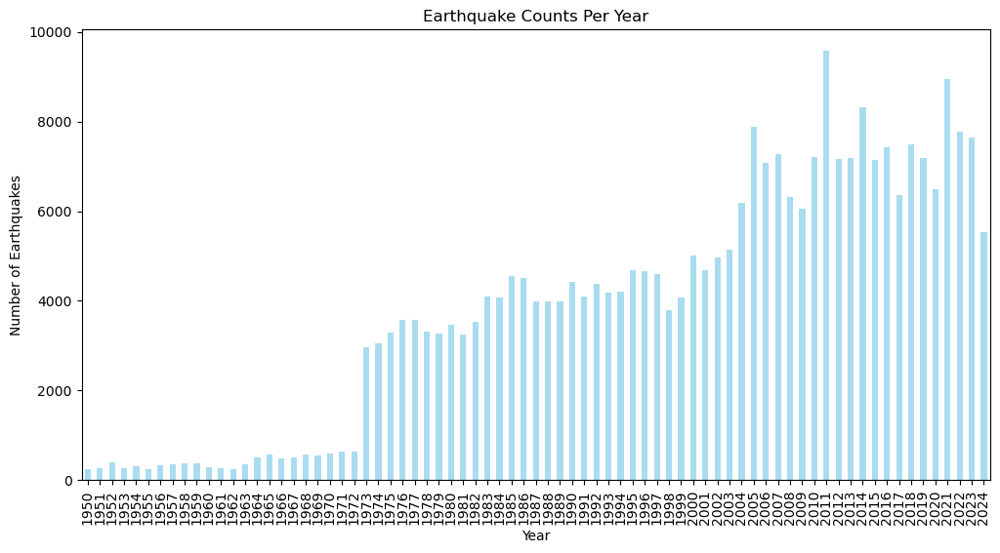

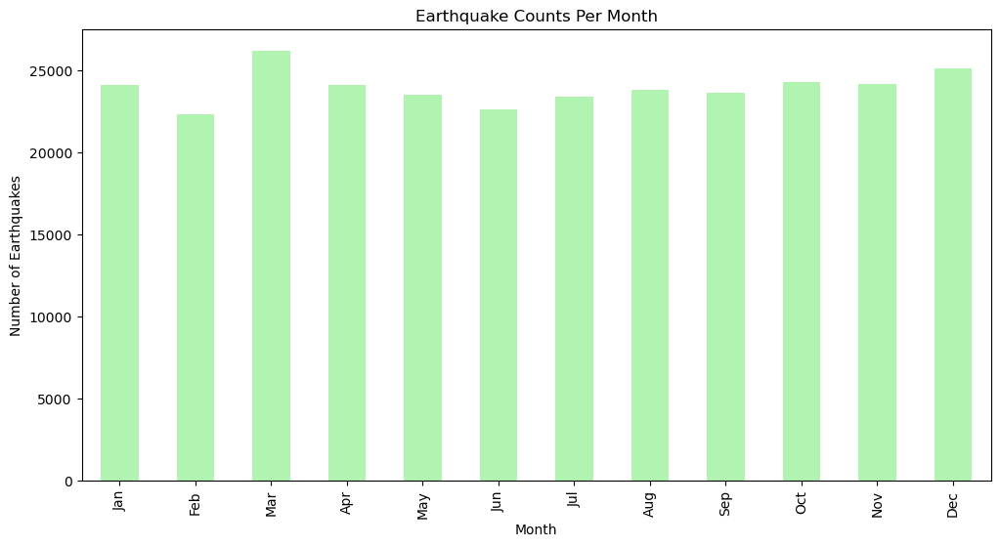

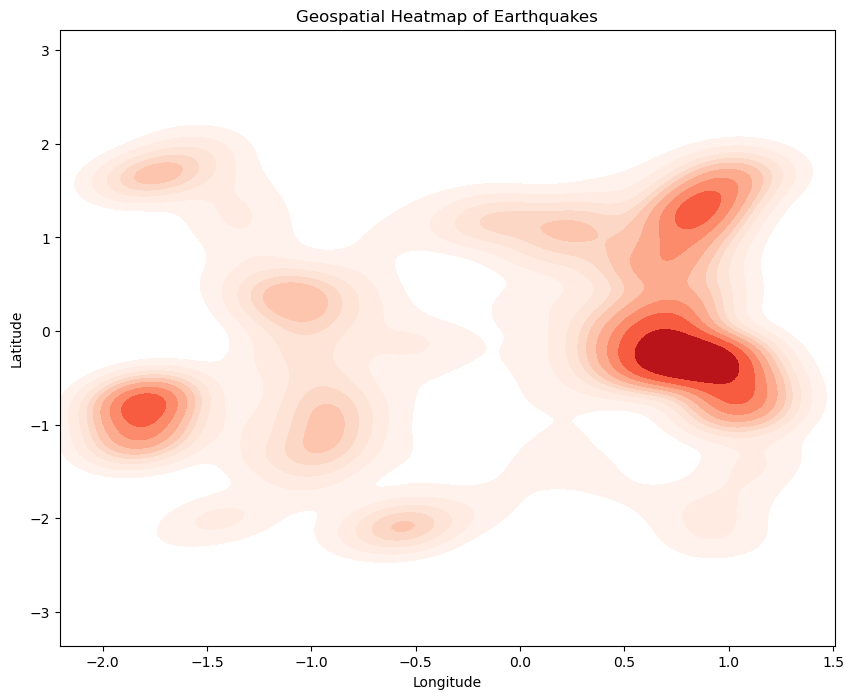

In [40]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from mpl_toolkits.basemap import Basemap

# Plot earthquake counts over time (yearly, monthly, or daily)
plt.figure(figsize=(12, 6))
df['year'].value_counts().sort_index().plot(kind='bar', color='skyblue', alpha=0.7)
plt.title('Earthquake Counts Per Year')
plt.xlabel('Year')
plt.ylabel('Number of Earthquakes')
plt.show()

plt.figure(figsize=(12, 6))
df['month'].value_counts().sort_index().plot(kind='bar', color='lightgreen', alpha=0.7)
plt.title('Earthquake Counts Per Month')
plt.xlabel('Month')
plt.ylabel('Number of Earthquakes')
plt.xticks(ticks=range(12), labels=[
    'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
    'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'
])
plt.show()

# Geospatial heatmap
# Replace negative or missing magnitudes with zero
df['mag'] = df['mag'].apply(lambda x: max(x, 0) if pd.notnull(x) else 0)

plt.figure(figsize=(10, 8))
sns.kdeplot(
    x=df['longitude'], 
    y=df['latitude'], 
    weights=df['mag'],  # Ensure weights are non-negative
    cmap='Reds', 
    fill=True, 
    thresh=0.05
)
plt.title('Geospatial Heatmap of Earthquakes')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


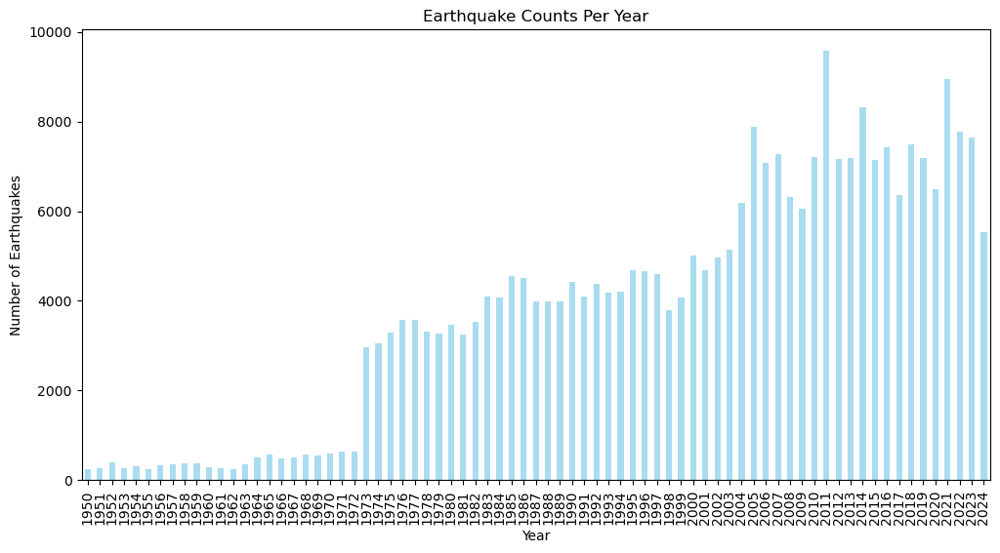

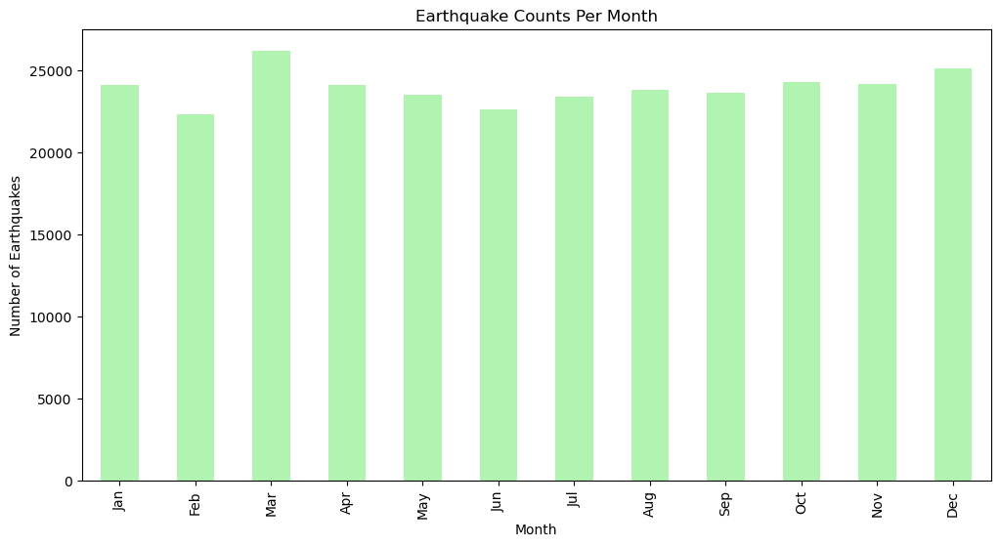

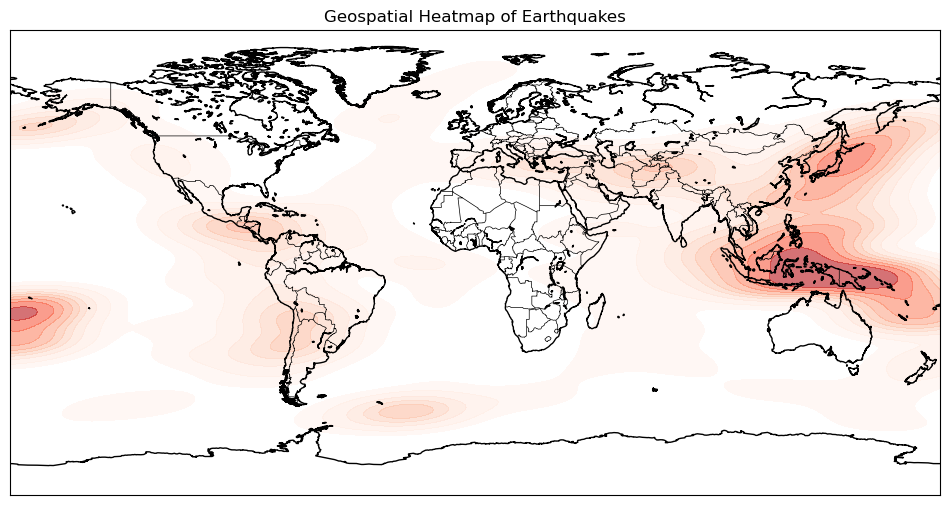

Done


In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from mpl_toolkits.basemap import Basemap

# Plot earthquake counts over time (yearly, monthly, or daily)
plt.figure(figsize=(12, 6))
df['year'].value_counts().sort_index().plot(kind='bar', color='skyblue', alpha=0.7)
plt.title('Earthquake Counts Per Year')
plt.xlabel('Year')
plt.ylabel('Number of Earthquakes')
plt.show()

plt.figure(figsize=(12, 6))
df['month'].value_counts().sort_index().plot(kind='bar', color='lightgreen', alpha=0.7)
plt.title('Earthquake Counts Per Month')
plt.xlabel('Month')
plt.ylabel('Number of Earthquakes')
plt.xticks(ticks=range(12), labels=[
    'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
    'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'
])
plt.show()

import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.basemap import Basemap

# Geospatial heatmap with Earth map in the background
plt.figure(figsize=(12, 8))
m = Basemap(
    projection='cyl',
    llcrnrlat=-90,
    urcrnrlat=90,
    llcrnrlon=-180,
    urcrnrlon=180,
    resolution='l'
)

# Draw coastlines and countries
m.drawcoastlines()
m.drawcountries()

# Plot the geospatial density
sns.kdeplot(
    x=df['longitude'],
    y=df['latitude'],
    weights=df['mag'],  # Ensure weights are non-negative
    cmap='Reds',
    fill=True,
    thresh=0.05,
    alpha=0.6
)

plt.title('Geospatial Heatmap of Earthquakes')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

print("Done")


In [9]:
import plotly.express as px

# Ensure your dataset contains 'latitude', 'longitude', and 'mag'
filtered_data = df  # Replace with your filtered or full dataset

# Create the density heatmap with Mapbox
heatmap_fig = px.density_mapbox(
    filtered_data,
    lat='latitude',
    lon='longitude',
    z='mag',  # The variable to color-scale the heatmap
    radius=10,  # Radius of influence for each data point
    center={"lat": filtered_data['latitude'].mean(), "lon": filtered_data['longitude'].mean()},
    zoom=3,  # Initial zoom level
    mapbox_style="carto-positron",  # Mapbox style
    title='Geospatial Heatmap of Earthquakes'
)

# Show the figure
heatmap_fig.show()

# Understanding Relationships

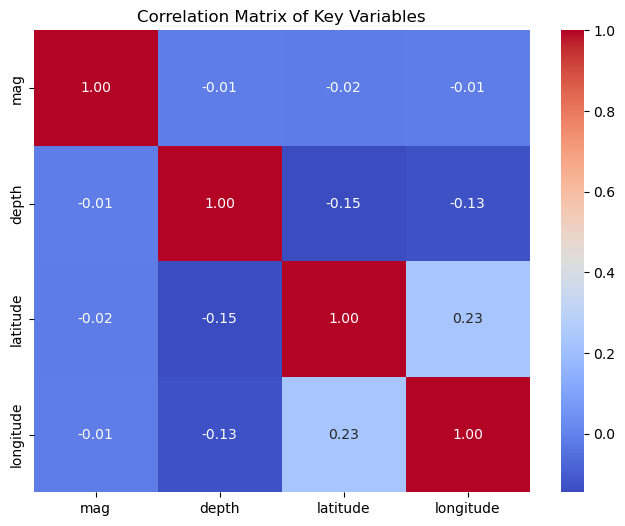

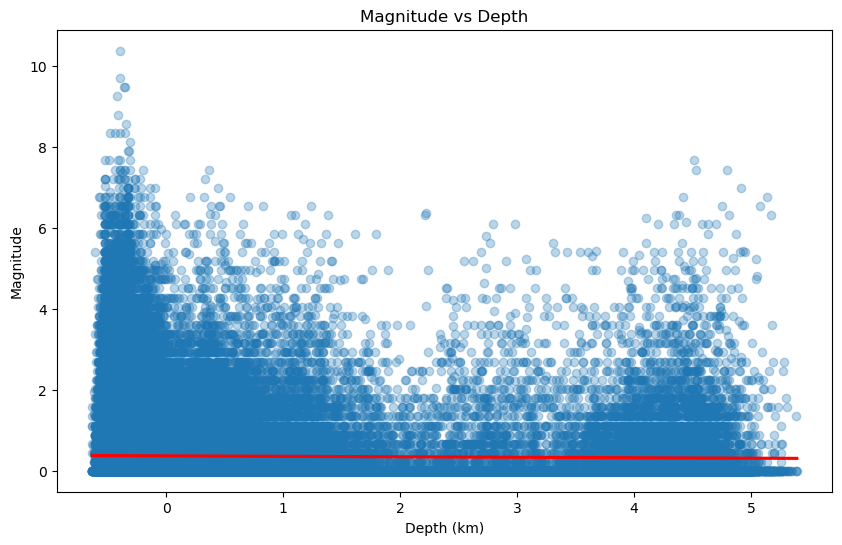

In [9]:
# Correlation analysis for key variables
correlation_matrix = df[['mag', 'depth', 'latitude', 'longitude']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of Key Variables')
plt.show()

# Scatterplot and regression line for magnitude vs. depth
plt.figure(figsize=(10, 6))
sns.regplot(x='depth', y='mag', data=df, scatter_kws={'alpha':0.3}, line_kws={'color': 'red'})
plt.title('Magnitude vs Depth')
plt.xlabel('Depth (km)')
plt.ylabel('Magnitude')
plt.show()

# Error Analysis

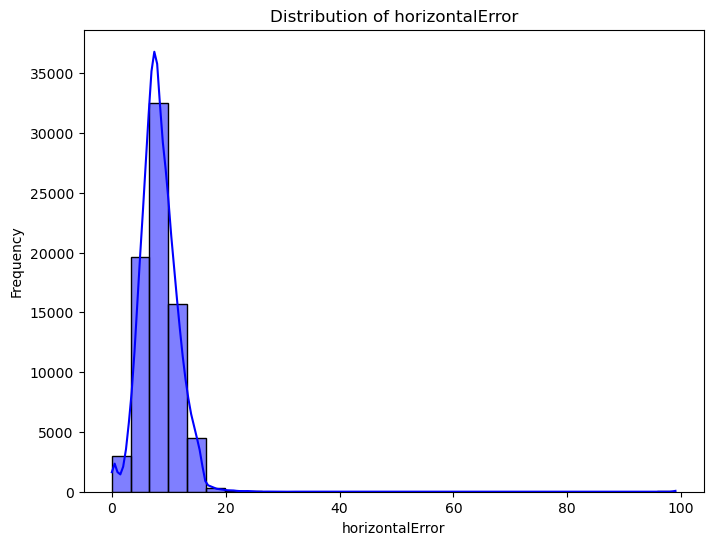

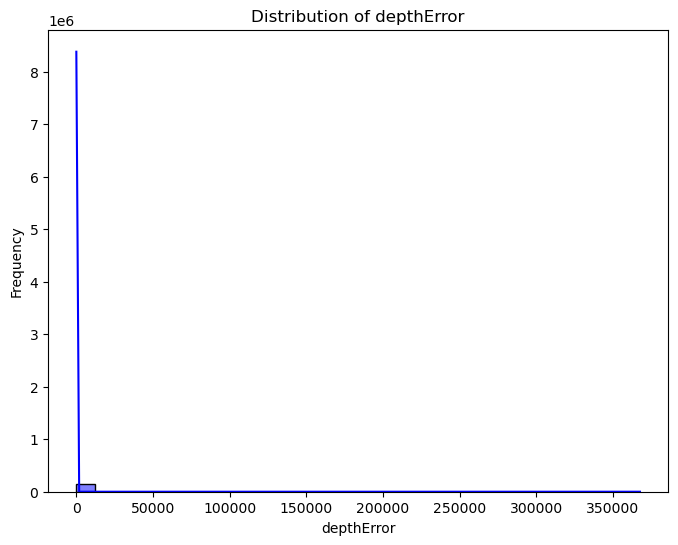

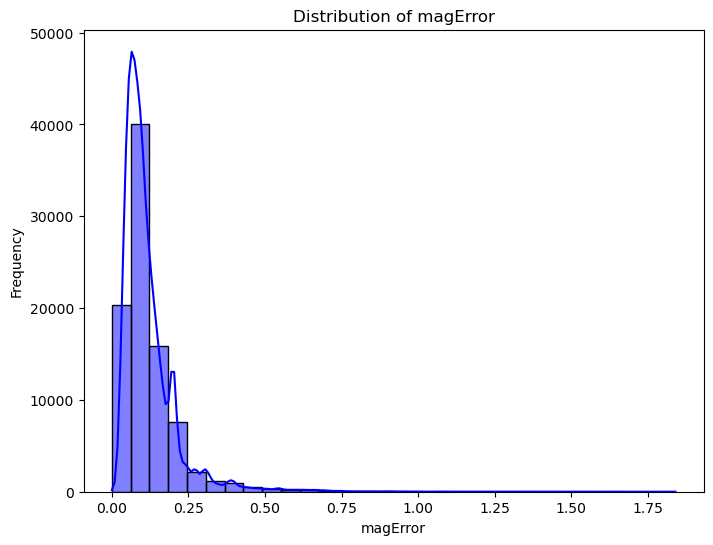

C:\Users\Ashik\AppData\Local\Temp\ipykernel_5400\640548940.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned['horizontalError'] = pd.to_numeric(df_cleaned['horizontalError'], errors='coerce')


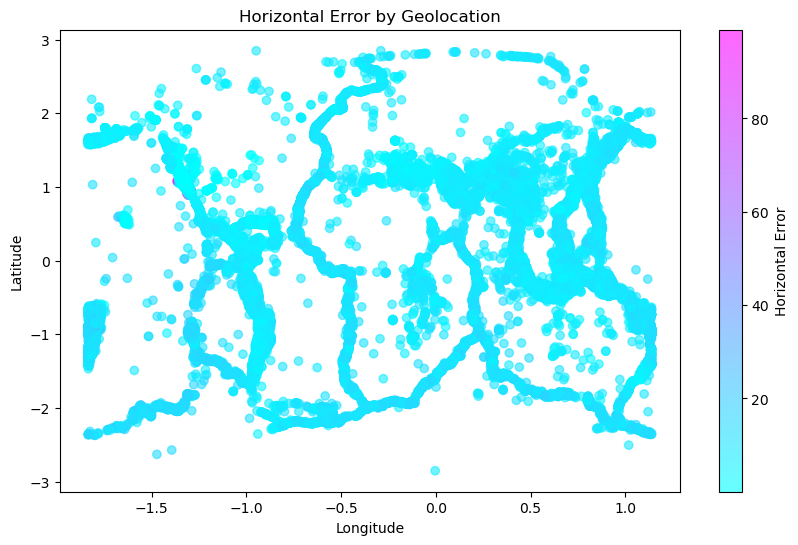

C:\Users\Ashik\AppData\Local\Temp\ipykernel_5400\640548940.py:44: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  df['year_month'] = df['time'].dt.to_period('M')
C:\Users\Ashik\AppData\Local\Temp\ipykernel_5400\640548940.py:48: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='year', y='horizontalError', label='Horizontal Error', ci=None)
C:\Users\Ashik\AppData\Local\Temp\ipykernel_5400\640548940.py:49: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='year', y='depthError', label='Depth Error', ci=None)
C:\Users\Ashik\AppData\Local\Temp\ipykernel_5400\640548940.py:50: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='year', y='magError', label='Magnitude Error', ci=None)


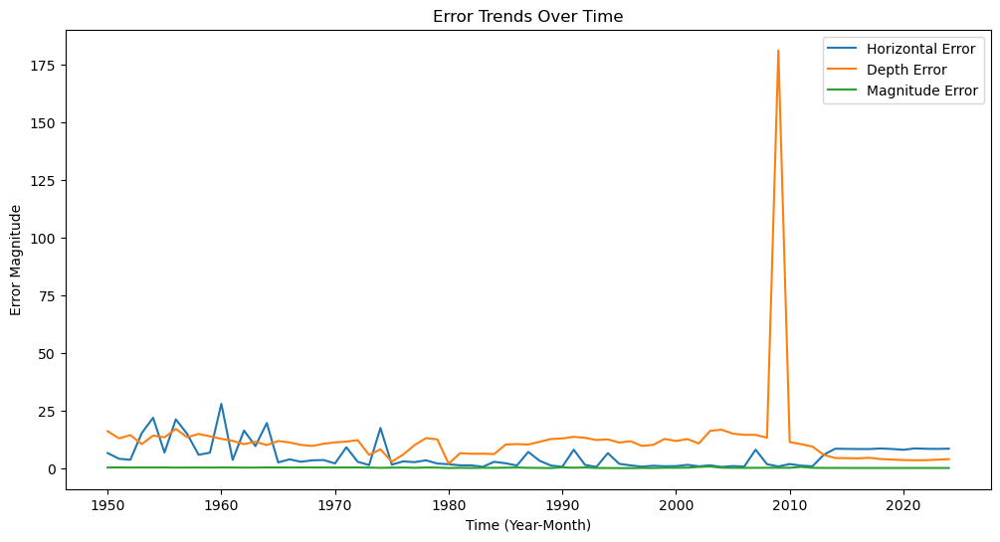

C:\Users\Ashik\AppData\Local\Temp\ipykernel_5400\640548940.py:59: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='month', y='horizontalError', label='Horizontal Error', ci=None)
C:\Users\Ashik\AppData\Local\Temp\ipykernel_5400\640548940.py:60: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='month', y='depthError', label='Depth Error', ci=None)
C:\Users\Ashik\AppData\Local\Temp\ipykernel_5400\640548940.py:61: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='month', y='magError', label='Magnitude Error', ci=None)


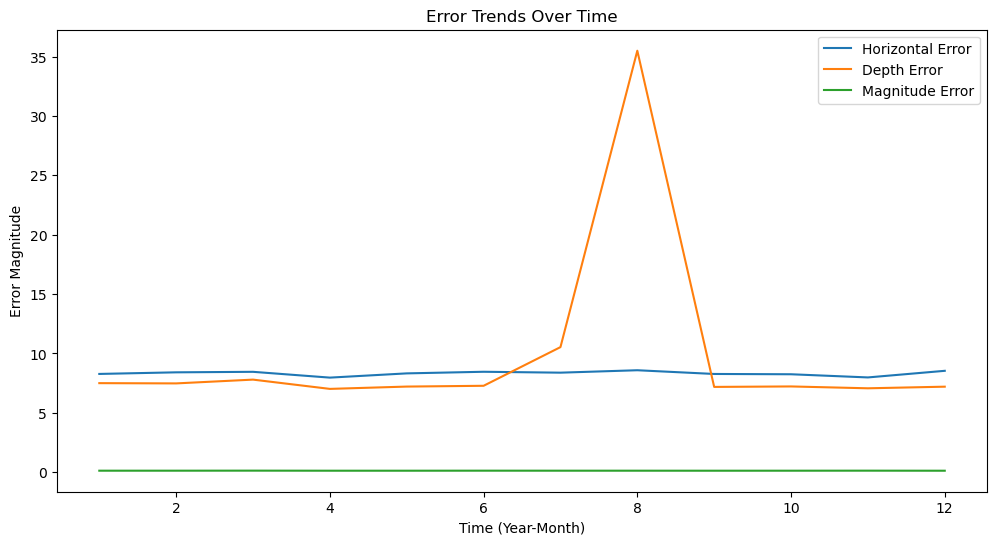

Done
Done


In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Distributions of error variables
error_columns = ['horizontalError', 'depthError', 'magError']
for error_col in error_columns:
    if error_col in df.columns:
        plt.figure(figsize=(8, 6))
        sns.histplot(df[error_col].dropna(), kde=True, bins=30, color='blue')
        plt.title(f'Distribution of {error_col}')
        plt.xlabel(error_col)
        plt.ylabel('Frequency')
        plt.show()

# 2. Visualize error trends across regions using scatterplot with color mapping
# Drop rows with NaN in 'horizontalError', 'latitude', or 'longitude'
df_cleaned = df.dropna(subset=['horizontalError', 'latitude', 'longitude'])

# Ensure 'horizontalError' is a valid numeric type for color mapping
df_cleaned['horizontalError'] = pd.to_numeric(df_cleaned['horizontalError'], errors='coerce')

# Drop rows where 'horizontalError' is NaN after coercion
df_cleaned = df_cleaned.dropna(subset=['horizontalError'])

plt.figure(figsize=(10, 6))
scatter = plt.scatter(
    x=df_cleaned['longitude'], 
    y=df_cleaned['latitude'], 
    c=df_cleaned['horizontalError'],  # Map 'horizontalError' to color
    cmap='cool', 
    alpha=0.6
)
plt.title('Horizontal Error by Geolocation')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Add a colorbar to show error values
plt.colorbar(scatter, label='Horizontal Error')
plt.show()

# 3. Error trends over time
if 'time' in df.columns:
    # Create 'year_month' period for grouping by month and year
    df['year_month'] = df['time'].dt.to_period('M')

    # Plot the error trends over time(Year)
    plt.figure(figsize=(12, 6))
    sns.lineplot(data=df, x='year', y='horizontalError', label='Horizontal Error', ci=None)
    sns.lineplot(data=df, x='year', y='depthError', label='Depth Error', ci=None)
    sns.lineplot(data=df, x='year', y='magError', label='Magnitude Error', ci=None)
    plt.title('Error Trends Over Time')
    plt.xlabel('Time (Year-Month)')
    plt.ylabel('Error Magnitude')
    plt.legend()
    plt.show()
    
    # Plot the error trends over time(Month)
    plt.figure(figsize=(12, 6))
    sns.lineplot(data=df, x='month', y='horizontalError', label='Horizontal Error', ci=None)
    sns.lineplot(data=df, x='month', y='depthError', label='Depth Error', ci=None)
    sns.lineplot(data=df, x='month', y='magError', label='Magnitude Error', ci=None)
    plt.title('Error Trends Over Time')
    plt.xlabel('Time (Year-Month)')
    plt.ylabel('Error Magnitude')
    plt.legend()
    plt.show()
    
    print('Done')
    
print("Done")

# 3. Machine Learning

## 3.1 Predict Earthquake Magnitude

In [12]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
import lightgbm as lgb
import numpy as np

# 1. Prepare Data
# Convert 'magType' categorical variable into numeric encoding
#label_encoder = LabelEncoder()
#df['magType_encoded'] = label_encoder.fit_transform(df['magType'])

# Select features (latitude, longitude, depth, temporal features, magType_encoded)
features = ['latitude', 'longitude', 'depth', 'year', 'month', 'hour', 'magType_numeric']
X = df[features].dropna()  # Ensure no missing values
y = df['mag'].dropna()

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 2. Models
# Linear Regression (Baseline model)
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)
y_pred_lr = lr_model.predict(X_test)

# Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)
y_pred_rf = rf_model.predict(X_test)

# XGBoost
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", n_estimators=100, random_state=42)
xgb_model.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)

# LightGBM
lgb_model = lgb.LGBMRegressor(n_estimators=100, random_state=42)
lgb_model.fit(X_train, y_train)
y_pred_lgb = lgb_model.predict(X_test)

# 3. Metrics: MAE and RMSE
def evaluate_model(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return mae, rmse

# Evaluate models
mae_lr, rmse_lr = evaluate_model(y_test, y_pred_lr)
mae_rf, rmse_rf = evaluate_model(y_test, y_pred_rf)
mae_xgb, rmse_xgb = evaluate_model(y_test, y_pred_xgb)
mae_lgb, rmse_lgb = evaluate_model(y_test, y_pred_lgb)

print(f"Linear Regression - MAE: {mae_lr}, RMSE: {rmse_lr}")
print(f"Random Forest - MAE: {mae_rf}, RMSE: {rmse_rf}")
print(f"XGBoost - MAE: {mae_xgb}, RMSE: {rmse_xgb}")
print(f"LightGBM - MAE: {mae_lgb}, RMSE: {rmse_lgb}")


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 896
[LightGBM] [Info] Number of data points in the train set: 229555, number of used features: 7
[LightGBM] [Info] Start training from score 0.367969
Linear Regression - MAE: 0.44874494643392454, RMSE: 0.7209201712661512
Random Forest - MAE: 0.25914243306409335, RMSE: 0.495386943859392
XGBoost - MAE: 0.2551881247101678, RMSE: 0.4884764000492607
LightGBM - MAE: 0.25644683931638423, RMSE: 0.48900549054077364


## 3.2 Clustering Pattern

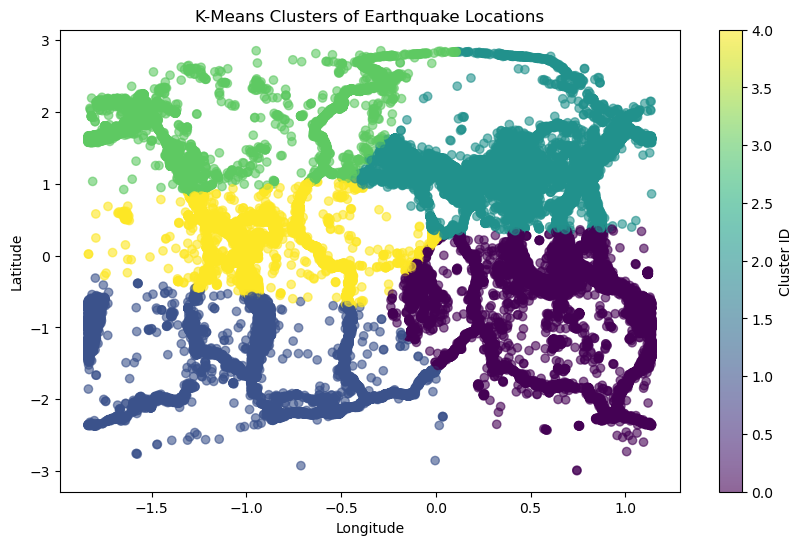

DOne


In [14]:
from sklearn.cluster import KMeans, DBSCAN
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point

# 1. Prepare Data for Clustering
geospatial_features = df[['latitude', 'longitude']].dropna()

# 2. K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
df['kmeans_cluster'] = kmeans.fit_predict(geospatial_features)

# Plot K-Means clusters
plt.figure(figsize=(10, 6))
plt.scatter(df['longitude'], df['latitude'], c=df['kmeans_cluster'], cmap='viridis', alpha=0.6)
plt.title('K-Means Clusters of Earthquake Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Cluster ID')
plt.show()
print("DOne")

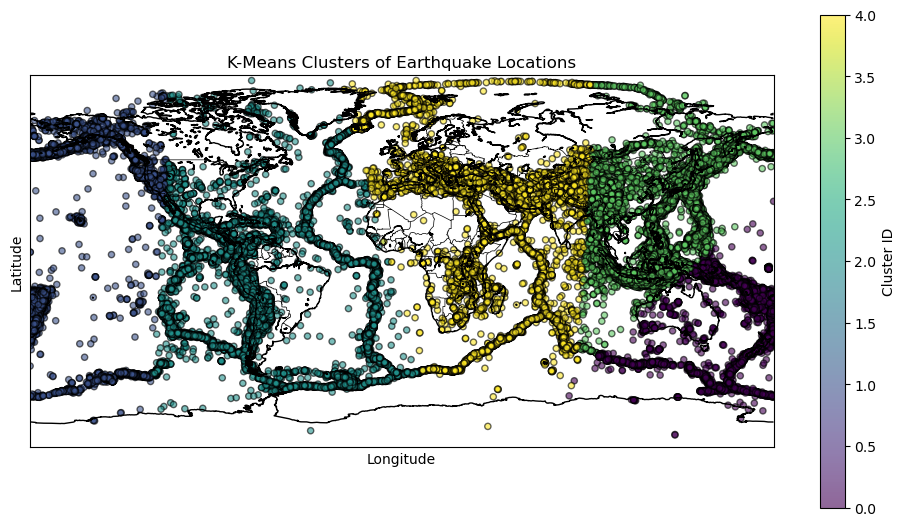

In [6]:
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
from sklearn.cluster import KMeans
import numpy as np

# Ensure your dataset contains 'latitude' and 'longitude'
geospatial_features = df[['latitude', 'longitude']].dropna()

# K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
df['kmeans_cluster'] = kmeans.fit_predict(geospatial_features)

# Plot K-Means clusters with a map background
plt.figure(figsize=(12, 8))

# Initialize Basemap
m = Basemap(
    projection='cyl',  # Cylindrical projection
    llcrnrlat=-90, urcrnrlat=90,  # Latitude bounds
    llcrnrlon=-180, urcrnrlon=180,  # Longitude bounds
    resolution='l'  # Low resolution
)

# Draw coastlines and countries
m.drawcoastlines()
m.drawcountries()

# Scatter plot for K-Means clusters
scatter = plt.scatter(
    df['longitude'], 
    df['latitude'], 
    c=df['kmeans_cluster'], 
    cmap='viridis', 
    alpha=0.6, 
    edgecolor='k', 
    s=20  # Marker size
)

# Add title and labels
plt.title('K-Means Clusters of Earthquake Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Add color bar
cbar = plt.colorbar(scatter, shrink=0.8, pad=0.05)
cbar.set_label('Cluster ID')

# Show the plot
plt.show()


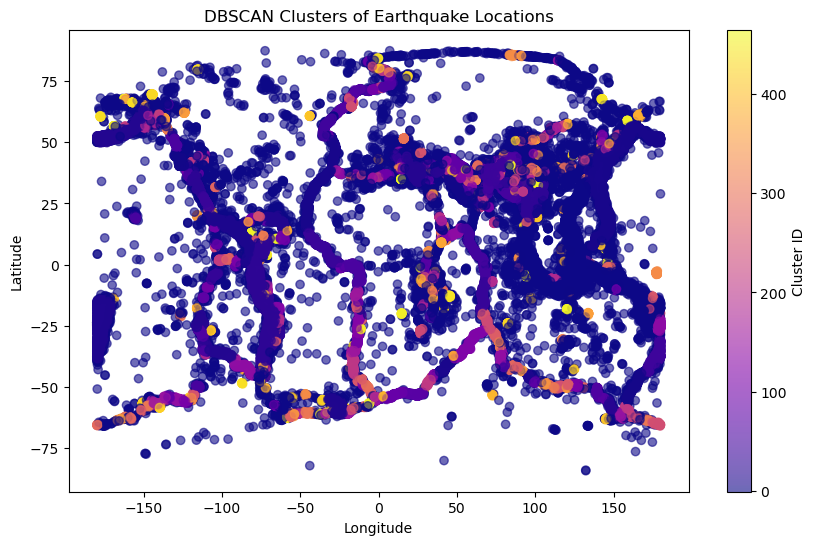

Done


In [6]:
from sklearn.cluster import KMeans, DBSCAN
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point

# 1. Prepare Data for Clustering
geospatial_features = df[['latitude', 'longitude']].dropna()

# 3. DBSCAN Clustering (Density-Based Clustering)
dbscan = DBSCAN(eps=0.5, min_samples=10)
df['dbscan_cluster'] = dbscan.fit_predict(geospatial_features)

# Plot DBSCAN clusters
plt.figure(figsize=(10, 6))
plt.scatter(df['longitude'], df['latitude'], c=df['dbscan_cluster'], cmap='plasma', alpha=0.6)
plt.title('DBSCAN Clusters of Earthquake Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Cluster ID')
plt.show()
print("Done")

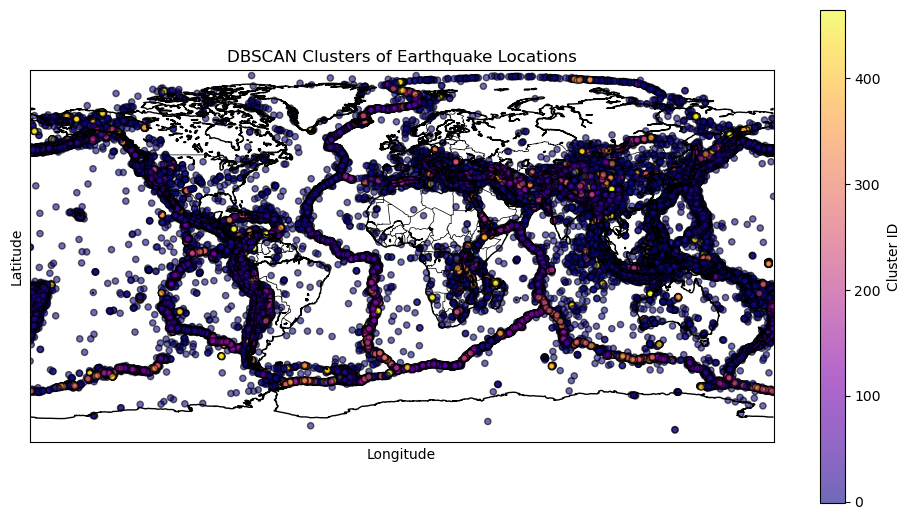

In [8]:
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
from sklearn.cluster import DBSCAN

# Ensure your dataset contains 'latitude' and 'longitude'
geospatial_features = df[['latitude', 'longitude']].dropna()

# DBSCAN Clustering
dbscan = DBSCAN(eps=0.5, min_samples=10)
df['dbscan_cluster'] = dbscan.fit_predict(geospatial_features)

# Plot DBSCAN clusters with a map background
plt.figure(figsize=(12, 8))

# Initialize Basemap
m = Basemap(
    projection='cyl',  # Cylindrical projection
    llcrnrlat=-90, urcrnrlat=90,  # Latitude bounds
    llcrnrlon=-180, urcrnrlon=180,  # Longitude bounds
    resolution='l'  # Low resolution
)

# Draw coastlines and countries
m.drawcoastlines()
m.drawcountries()

# Scatter plot for DBSCAN clusters
scatter = plt.scatter(
    df['longitude'], 
    df['latitude'], 
    c=df['dbscan_cluster'], 
    cmap='plasma', 
    alpha=0.6, 
    edgecolor='k', 
    s=20  # Marker size
)

# Add title and labels
plt.title('DBSCAN Clusters of Earthquake Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Add color bar
cbar = plt.colorbar(scatter, shrink=0.8, pad=0.05)
cbar.set_label('Cluster ID')

# Show the plot
plt.show()


## 3.3 Anomaly Detection 

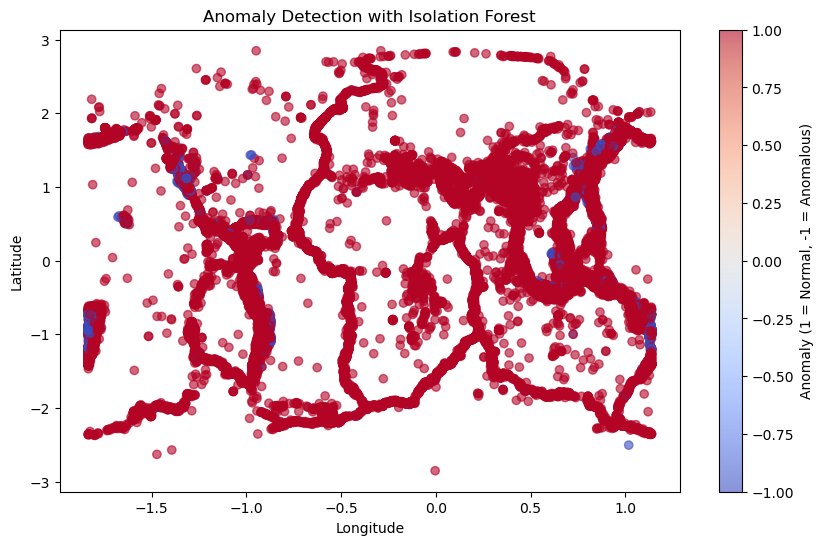

C:\Users\Ashik\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


2366/2366 ━━━━━━━━━━━━━━━━━━━━ 2s 890us/step


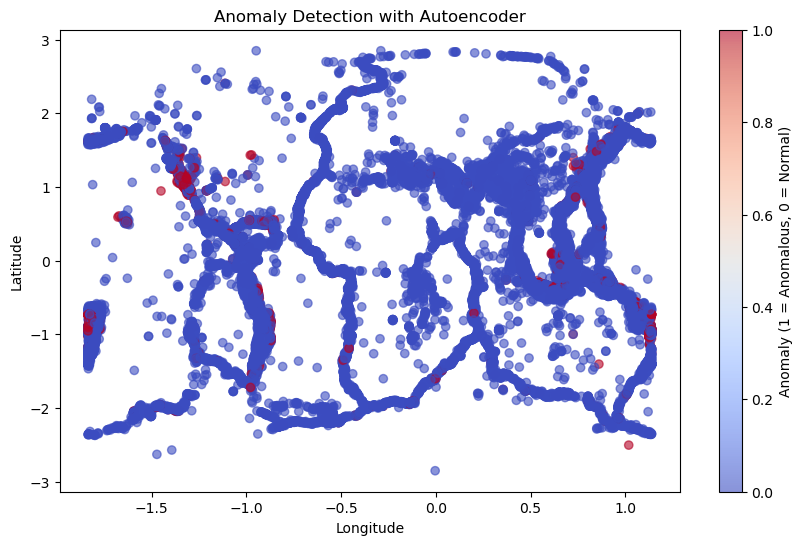

Done


In [16]:
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# 1. Prepare Data for Anomaly Detection
features_for_anomaly = ['mag', 'depth', 'horizontalError', 'depthError']
df_anomaly = df[features_for_anomaly].dropna()  # Remove rows with missing values

# Standardize the features
scaler = StandardScaler()
df_anomaly_scaled = scaler.fit_transform(df_anomaly)

# 2. Isolation Forest for Anomaly Detection
iso_forest = IsolationForest(contamination=0.05, random_state=42)
df_anomaly['anomaly_if'] = iso_forest.fit_predict(df_anomaly_scaled)

# Map results back to the original dataframe
df['anomaly_if'] = np.nan
df.loc[df_anomaly.index, 'anomaly_if'] = df_anomaly['anomaly_if']

# Plot Anomalies Detected by Isolation Forest
plt.figure(figsize=(10, 6))
plt.scatter(df['longitude'], df['latitude'], c=df['anomaly_if'], cmap='coolwarm', alpha=0.6)
plt.title('Anomaly Detection with Isolation Forest')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Anomaly (1 = Normal, -1 = Anomalous)')
plt.show()

# 3. Autoencoders for Anomaly Detection
# Define a simple Autoencoder model
autoencoder = Sequential([
    Dense(32, input_dim=df_anomaly_scaled.shape[1], activation='relu'),
    Dense(16, activation='relu'),
    Dense(8, activation='relu'),
    Dense(16, activation='relu'),
    Dense(32, activation='relu'),
    Dense(df_anomaly_scaled.shape[1], activation='sigmoid')
])

autoencoder.compile(optimizer='adam', loss='mse')
autoencoder.fit(df_anomaly_scaled, df_anomaly_scaled, epochs=10, batch_size=32, verbose=0)

# Get reconstruction errors
reconstruction_error = np.mean(np.abs(df_anomaly_scaled - autoencoder.predict(df_anomaly_scaled)), axis=1)
threshold = np.percentile(reconstruction_error, 95)  # Set threshold for anomalies
df_anomaly['anomaly_autoencoder'] = (reconstruction_error > threshold).astype(int)

# Map results back to the original dataframe
df['anomaly_autoencoder'] = np.nan
df.loc[df_anomaly.index, 'anomaly_autoencoder'] = df_anomaly['anomaly_autoencoder']

# Plot Anomalies Detected by Autoencoder
plt.figure(figsize=(10, 6))
plt.scatter(df['longitude'], df['latitude'], c=df['anomaly_autoencoder'], cmap='coolwarm', alpha=0.6)
plt.title('Anomaly Detection with Autoencoder')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Anomaly (1 = Anomalous, 0 = Normal)')
plt.show()
print("Done")

# 4. Probability Modeling

## 4.1 Estimate Likelihood of High-Magnitude Earthquakes

###  Fit a Poisson Model with statsmodels

In [41]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
from scipy.stats import poisson

# Example data: Replace with your actual dataset
high_mag_threshold = 6.0
high_mag_data = df[df['mag'] >= high_mag_threshold]  # Filter high-magnitude earthquakes
region_counts = high_mag_data.groupby(['year', 'month']).size().reset_index(name='event_counts')

# Extract counts for modeling
counts = region_counts['event_counts']
print("Done")

Done


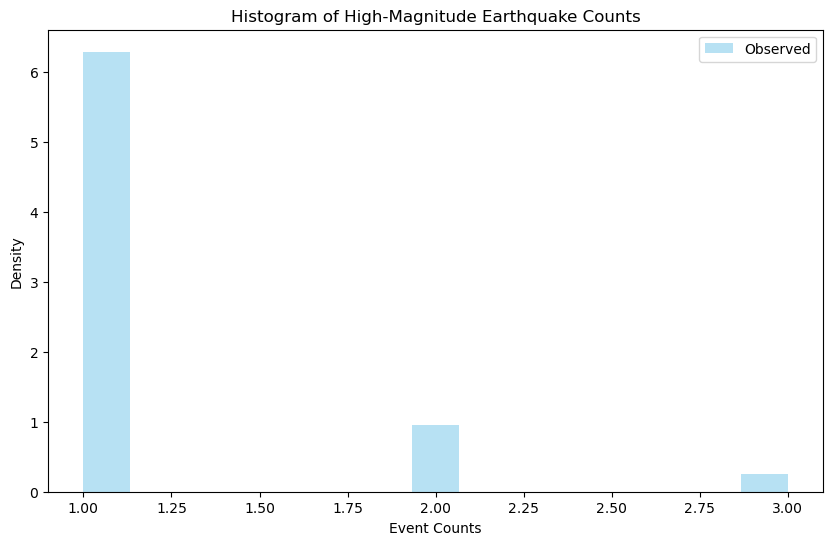

                 Generalized Linear Model Regression Results                  
Dep. Variable:           event_counts   No. Observations:                  205
Model:                            GLM   Df Residuals:                      204
Model Family:                 Poisson   Df Model:                            0
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -231.89
Date:                Wed, 04 Dec 2024   Deviance:                       30.887
Time:                        02:31:22   Pearson chi2:                     38.7
No. Iterations:                     4   Pseudo R-squ. (CS):              0.000
Covariance Type:            nonrobust                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.1782      0.064      2.790      0.0

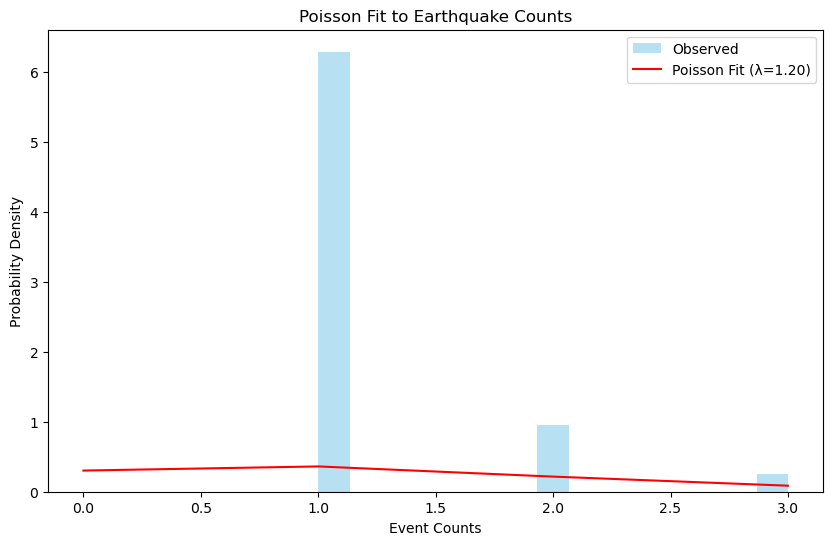

Done


In [17]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
from scipy.stats import poisson

# Example data: Replace with your actual dataset
high_mag_threshold = 6.0
high_mag_data = df[df['mag'] >= high_mag_threshold]  # Filter high-magnitude earthquakes
region_counts = high_mag_data.groupby(['year', 'month']).size().reset_index(name='event_counts')

# Extract counts for modeling
counts = region_counts['event_counts']

# Plot histogram of counts
plt.figure(figsize=(10, 6))
plt.hist(counts, bins=15, density=True, alpha=0.6, color='skyblue', label='Observed')
plt.title('Histogram of High-Magnitude Earthquake Counts')
plt.xlabel('Event Counts')
plt.ylabel('Density')
plt.legend()
plt.show()

# Fit a Poisson regression model (constant mean)
X = np.ones(len(counts))  # Design matrix with only intercept
poisson_model = sm.GLM(counts, X, family=sm.families.Poisson()).fit()

# Summary of the model
print(poisson_model.summary())

# Extract lambda (mean rate) from the model
lambda_hat = poisson_model.mu.mean()
print(f"Estimated Lambda (Mean Earthquake Count): {lambda_hat:.2f}")

# Compare observed counts with Poisson distribution
x = np.arange(0, max(counts) + 1)
poisson_pmf = poisson.pmf(x, mu=lambda_hat)

plt.figure(figsize=(10, 6))
plt.hist(counts, bins=15, density=True, alpha=0.6, color='skyblue', label='Observed')
plt.plot(x, poisson_pmf, 'r-', label=f'Poisson Fit (λ={lambda_hat:.2f})')
plt.title('Poisson Fit to Earthquake Counts')
plt.xlabel('Event Counts')
plt.ylabel('Probability Density')
plt.legend()
plt.show()
print("Done")

### Fit an Exponential Model (Bayesian-Free) 

C:\Users\Ashik\AppData\Local\Temp\ipykernel_14692\2362552886.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Estimated Rate (1/Scale): 0.3695 events/day


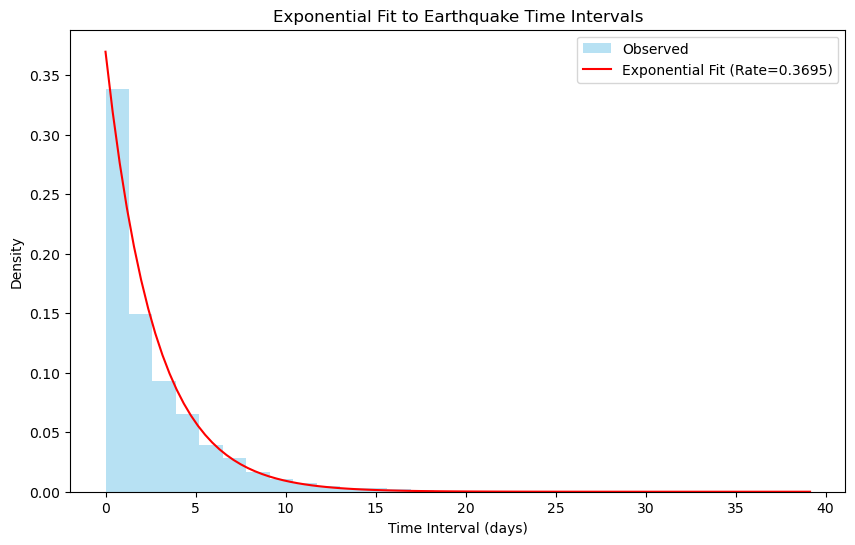

Done


In [32]:
# Ensure 'time' is parsed correctly to datetime
high_mag_data['datetime'] = pd.to_datetime(high_mag_data['time'], format='mixed', errors='coerce')

# Check for parsing errors
if high_mag_data['datetime'].isnull().any():
    print("Some time values could not be parsed. Replacing them with NaN.")
    print(high_mag_data[high_mag_data['datetime'].isnull()]['time'])  # Display problematic values for review

# Drop rows with invalid datetime entries
high_mag_data = high_mag_data.dropna(subset=['datetime'])

# Sort values by datetime
high_mag_data = high_mag_data.sort_values('datetime')

# Calculate time intervals between earthquakes
high_mag_data['time_diff'] = high_mag_data['datetime'].diff().dt.total_seconds() / (60 * 60 * 24)  # Convert to days

# Remove NaN introduced by diff()
time_intervals = high_mag_data['time_diff'].dropna()

# Fit exponential distribution to time intervals
from scipy.stats import expon
loc, scale = expon.fit(time_intervals, floc=0)  # Force loc=0 for true exponential distribution
print(f"Estimated Rate (1/Scale): {1/scale:.4f} events/day")

# Plot histogram and exponential fit
import numpy as np
import matplotlib.pyplot as plt

x = np.linspace(0, time_intervals.max(), 100)
exp_pdf = expon.pdf(x, loc=loc, scale=scale)

plt.figure(figsize=(10, 6))
plt.hist(time_intervals, bins=30, density=True, alpha=0.6, color='skyblue', label='Observed')
plt.plot(x, exp_pdf, 'r-', label=f'Exponential Fit (Rate={1/scale:.4f})')
plt.title('Exponential Fit to Earthquake Time Intervals')
plt.xlabel('Time Interval (days)')
plt.ylabel('Density')
plt.legend()
plt.show()
print("Done")

## 4.2 Temporal Modeling for Future Predictions

### ARIMA Model

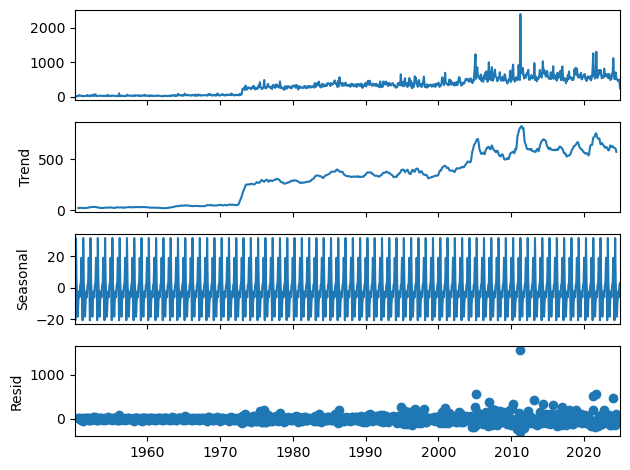

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  899
Model:                 ARIMA(2, 1, 2)   Log Likelihood               -5467.857
Date:                Sun, 08 Dec 2024   AIC                          10945.713
Time:                        21:34:17   BIC                          10969.714
Sample:                    01-31-1950   HQIC                         10954.883
                         - 11-30-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7847      0.102     -7.719      0.000      -0.984      -0.585
ar.L2          0.1228      0.033      3.691      0.000       0.058       0.188
ma.L1          0.0403      0.098      0.410      0.6

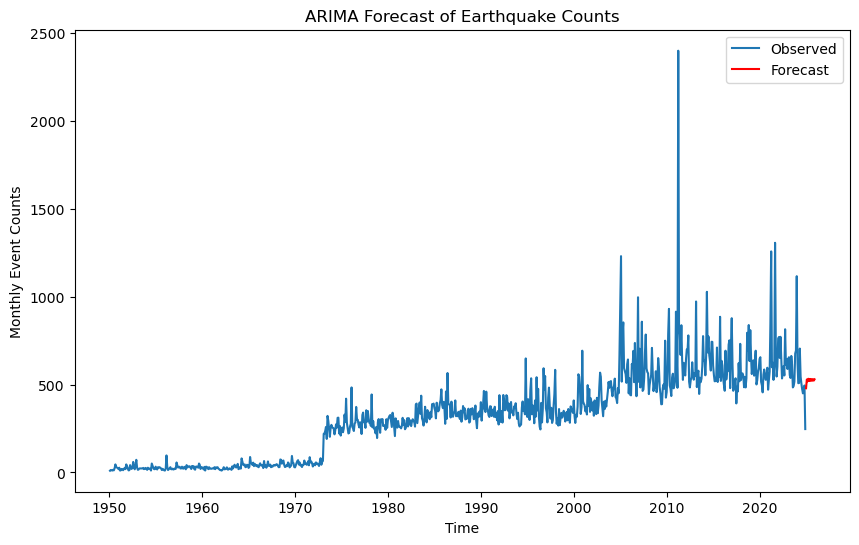

Done


In [16]:
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.seasonal import seasonal_decompose

# Time-series preparation
monthly_counts = df.groupby(['year', 'month']).size()
monthly_counts.index = pd.date_range(start=f"{df['year'].min()}-{df['month'].min()}",
                                     periods=len(monthly_counts), freq='M')

# Decomposition
decomposed = seasonal_decompose(monthly_counts, model='additive')
decomposed.plot()
plt.show()

# Fit ARIMA
arima_model = ARIMA(monthly_counts, order=(2, 1, 2))  # Order (p, d, q) chosen empirically
arima_results = arima_model.fit()
print(arima_results.summary())

# Forecast
forecast = arima_results.forecast(steps=12)  # Forecast next 12 months
plt.figure(figsize=(10, 6))
plt.plot(monthly_counts, label='Observed')
plt.plot(forecast, label='Forecast', color='red')
plt.title('ARIMA Forecast of Earthquake Counts')
plt.xlabel('Time')
plt.ylabel('Monthly Event Counts')
plt.legend()
plt.show()
print("Done")

### LSTM Model

Epoch 1/20


C:\Users\Ashik\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


45/45 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.5368 - val_loss: 0.7838
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0913 - val_loss: 0.7380
Epoch 3/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0711 - val_loss: 0.7198
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0909 - val_loss: 0.7231
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0964 - val_loss: 0.7119
Epoch 6/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0610 - val_loss: 0.6810
Epoch 7/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0799 - val_loss: 0.6872
Epoch 8/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0713 - val_loss: 0.7091
Epoch 9/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0616 - val_loss: 0.6670
Epoch 10/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0729 - val_loss: 0.6840
Epoch 11/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0722 - val_loss: 0.6595
Epoch 12/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0857 - val_loss: 0.6635


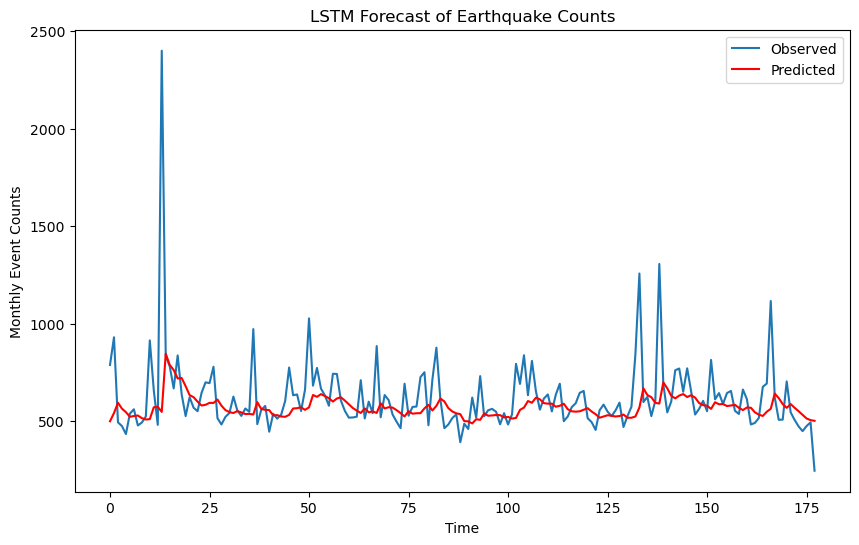

Done


In [20]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Data Preparation
time_series = monthly_counts.values.reshape(-1, 1)
scaler = StandardScaler()
time_series_scaled = scaler.fit_transform(time_series)

X, y = [], []
time_steps = 12
for i in range(len(time_series_scaled) - time_steps):
    X.append(time_series_scaled[i:i+time_steps])
    y.append(time_series_scaled[i+time_steps])

X, y = np.array(X), np.array(y)

# Train-Test Split
split_idx = int(0.8 * len(X))
X_train, X_test = X[:split_idx], X[split_idx:]
y_train, y_test = y[:split_idx], y[split_idx:]

# LSTM Model
lstm_model = Sequential([
    LSTM(64, activation='relu', input_shape=(X_train.shape[1], X_train.shape[2])),
    Dense(1)
])

lstm_model.compile(optimizer='adam', loss='mse')
lstm_model.fit(X_train, y_train, epochs=20, batch_size=16, validation_data=(X_test, y_test), verbose=1)

# Forecast
predicted = lstm_model.predict(X_test)
predicted_rescaled = scaler.inverse_transform(predicted)

plt.figure(figsize=(10, 6))
plt.plot(time_series[-len(y_test):], label='Observed')
plt.plot(predicted_rescaled, label='Predicted', color='red')
plt.title('LSTM Forecast of Earthquake Counts')
plt.xlabel('Time')
plt.ylabel('Monthly Event Counts')
plt.legend()
plt.show()

print("Done")

## 4.3 Develop Risk Maps 

In [11]:
import geopandas as gpd
import folium
from folium.plugins import HeatMap

# Create GeoDataFrame
geo_df = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['longitude'], df['latitude']))
geo_df = geo_df[~geo_df['mag'].isna()]  # Remove rows with missing magnitudes

# Plot Risk Zones using Folium
m = folium.Map(location=[geo_df['latitude'].mean(), geo_df['longitude'].mean()], zoom_start=5)

# Add earthquake heatmap
heat_data = [[row['latitude'], row['longitude'], row['mag']] for index, row in geo_df.iterrows()]
HeatMap(heat_data, radius=10, blur=15, max_zoom=1).add_to(m)

# Display map
m.save('earthquake_risk_map.html')  # Save as HTML
print("Done")

Done


In [12]:
import geopandas as gpd
import folium
from folium.plugins import HeatMap

# Create GeoDataFrame
geo_df = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['longitude'], df['latitude']))
geo_df = geo_df.dropna(subset=['mag'])  # Remove rows with missing magnitudes in 'mag' column

# Plot Risk Zones using Folium
m = folium.Map(location=[geo_df['latitude'].mean(), geo_df['longitude'].mean()], zoom_start=5)

# Add earthquake heatmap
heat_data = [[row['latitude'], row['longitude'], row['mag']] for idx, row in geo_df.iterrows()]
HeatMap(heat_data, radius=10, blur=15, max_zoom=1).add_to(m)

# Display map
m.save('earthquake_risk_map.html')  # Save as HTML
print("Done")

Done


# 5. Validation and Evaluation

## 5.1 Validate Machine Learning Models

In [22]:
# import numpy as np
from sklearn.model_selection import cross_validate
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import GradientBoostingRegressor

# Ensure 'time' is in datetime format and extract 'hour'
df['time'] = pd.to_datetime(df['time'], errors='coerce')
df['hour'] = df['time'].dt.hour

# Define features and target
features = ['latitude', 'longitude', 'depth', 'year', 'month', 'hour'] + \
           [col for col in df.columns if col.startswith('magType_')]
target = 'mag'

# Drop rows with missing or infinite values
df_cleaned = df[features + [target]].dropna()  # Remove rows with NaNs
df_cleaned = df_cleaned[np.isfinite(df_cleaned).all(axis=1)]  # Remove rows with infinite values

X = df_cleaned[features]
y = df_cleaned[target]

# Train-test split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Models to evaluate
models = {
    'Linear Regression': LinearRegression(),
    'Random Forest': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(n_estimators=100, random_state=42),
}

# Cross-validation and metrics
results = {}
for model_name, model in models.items():
    print(f"\nEvaluating {model_name}")
    try:
        scores = cross_validate(
            model,
            X_train,
            y_train,
            scoring=['neg_mean_absolute_error', 'neg_root_mean_squared_error', 'r2'],
            cv=5,
            error_score='raise',  # Raise errors for debugging
            return_train_score=True,
        )
        results[model_name] = {
            'MAE': -np.mean(scores['test_neg_mean_absolute_error']),
            'RMSE': -np.mean(scores['test_neg_root_mean_squared_error']),
            'R2': np.mean(scores['test_r2']),
        }
        print(f"MAE: {results[model_name]['MAE']:.4f}")
        print(f"RMSE: {results[model_name]['RMSE']:.4f}")
        print(f"R2: {results[model_name]['R2']:.4f}")
    except ValueError as e:
        print(f"Error evaluating {model_name}: {e}")

# Compare results
print("\nModel Comparison:")
for model_name, metrics in results.items():
    if metrics:
        print(f"{model_name}: MAE={metrics['MAE']:.4f}, RMSE={metrics['RMSE']:.4f}, R2={metrics['R2']:.4f}")
print("Done")


Evaluating Linear Regression
MAE: 535590.5919
RMSE: 86855656.8922
R2: -42120078674665144.0000

Evaluating Random Forest
MAE: 0.2630
RMSE: 0.4998
R2: 0.5847

Evaluating Gradient Boosting
MAE: 0.2683
RMSE: 0.5088
R2: 0.5695

Model Comparison:
Linear Regression: MAE=535590.5919, RMSE=86855656.8922, R2=-42120078674665144.0000
Random Forest: MAE=0.2630, RMSE=0.4998, R2=0.5847
Gradient Boosting: MAE=0.2683, RMSE=0.5088, R2=0.5695
Done


## 5.2 Validate Probability Models

C:\Users\Ashik\AppData\Local\Temp\ipykernel_14692\754595486.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



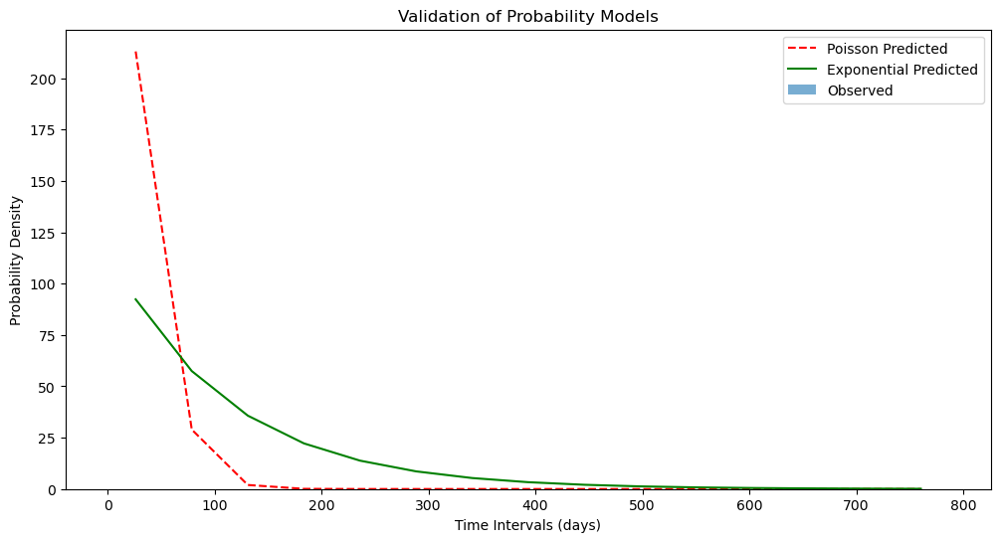

Model Validation Metrics:
Poisson Model - MAE: 16.2656, RMSE: 55.5030
Exponential Model - MAE: 16.2654, RMSE: 30.4399
Done


In [42]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import poisson, expon

# Step 1: Define the observed frequencies
# Create a test dataset by extracting time intervals between high-magnitude earthquakes
high_mag_data['datetime'] = pd.to_datetime(high_mag_data['time'])
high_mag_data = high_mag_data.sort_values('datetime')
high_mag_data['time_diff'] = high_mag_data['datetime'].diff().dt.total_seconds() / (60 * 60 * 24)  # Convert to days
time_intervals_test = high_mag_data['time_diff'].dropna()

# Bin the observed time intervals for frequency comparison
observed_counts, bin_edges = np.histogram(time_intervals_test, bins=15, density=True)
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

# Step 2: Use the fitted models to predict probabilities
# Poisson Model: Predict frequencies for event counts
lambda_hat = 1 / time_intervals_test.mean()  # Mean event rate from test data
poisson_probs = poisson.pmf(np.arange(len(bin_centers)), mu=lambda_hat * len(bin_centers))

# Exponential Model: Predict frequencies for time intervals
loc, scale = expon.fit(time_intervals_test, floc=0)  # Fitted parameters
exp_probs = expon.pdf(bin_centers, loc=loc, scale=scale)

# Normalize probabilities to match the observed frequencies' scale
poisson_probs = poisson_probs / sum(poisson_probs) * len(time_intervals_test)
exp_probs = exp_probs / sum(exp_probs) * len(time_intervals_test)

# Step 3: Visualize and Compare Probabilities
plt.figure(figsize=(12, 6))
plt.bar(bin_centers, observed_counts, width=(bin_edges[1] - bin_edges[0]), alpha=0.6, label='Observed')
plt.plot(bin_centers, poisson_probs[:len(bin_centers)], 'r--', label='Poisson Predicted')
plt.plot(bin_centers, exp_probs, 'g-', label='Exponential Predicted')
plt.xlabel('Time Intervals (days)')
plt.ylabel('Probability Density')
plt.title('Validation of Probability Models')
plt.legend()
plt.show()

# Step 4: Calculate Error Metrics for Validation
def calculate_error_metrics(observed, predicted):
    mae = np.mean(np.abs(observed - predicted))
    mse = np.mean((observed - predicted) ** 2)
    return mae, np.sqrt(mse)

poisson_mae, poisson_rmse = calculate_error_metrics(observed_counts, poisson_probs[:len(observed_counts)])
exp_mae, exp_rmse = calculate_error_metrics(observed_counts, exp_probs)

print("Model Validation Metrics:")
print(f"Poisson Model - MAE: {poisson_mae:.4f}, RMSE: {poisson_rmse:.4f}")
print(f"Exponential Model - MAE: {exp_mae:.4f}, RMSE: {exp_rmse:.4f}")
print("Done")

## 5.3 Interpret and Communicate Results 

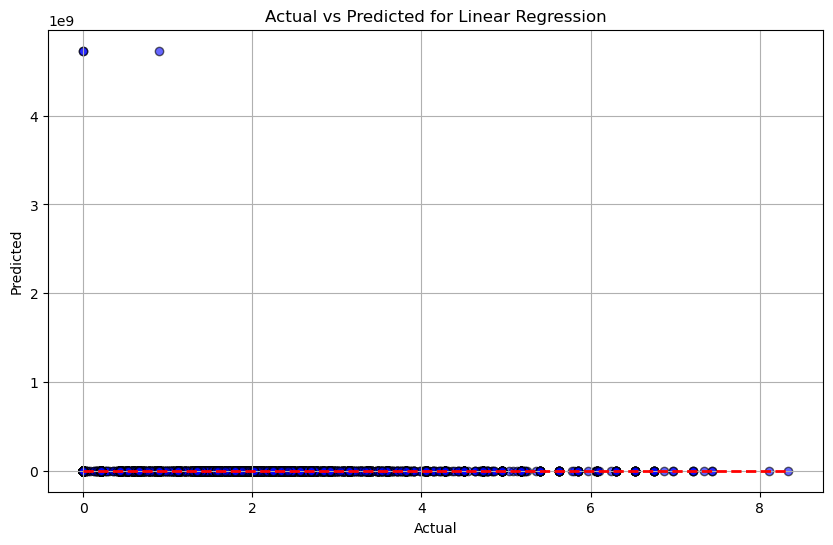

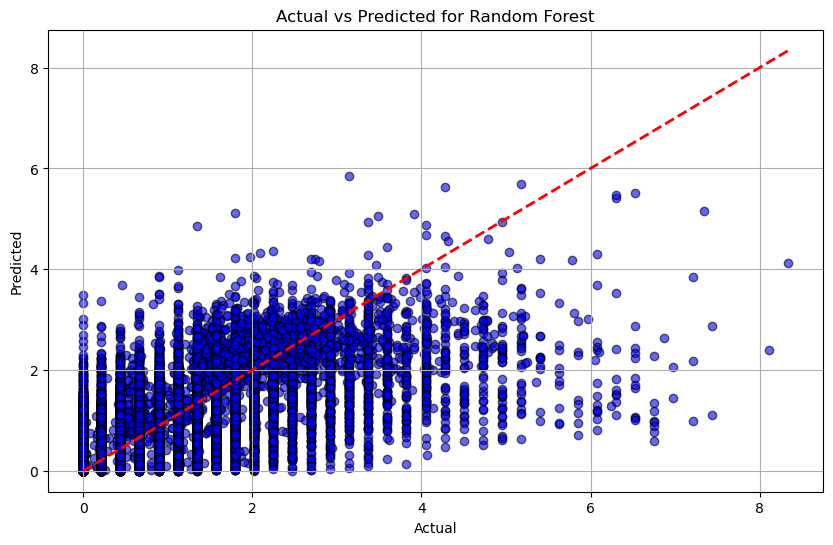

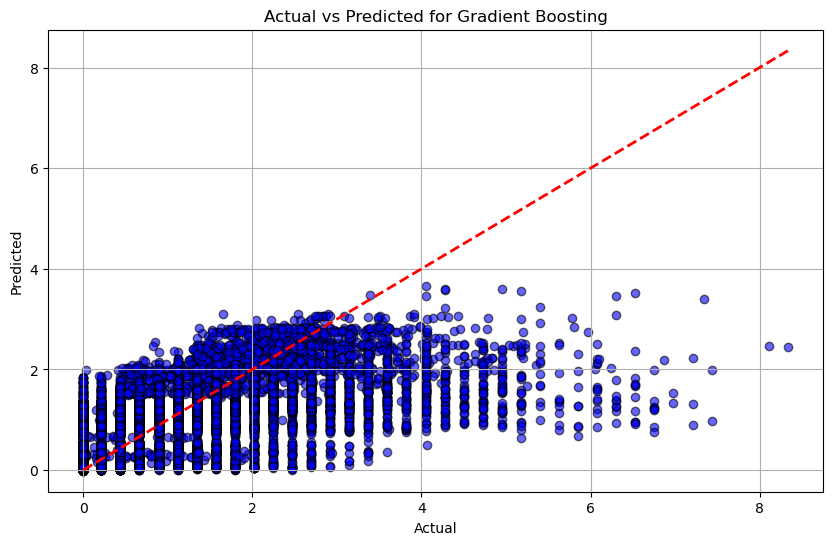

Model: Linear Regression
  - Mean Absolute Error (MAE): 247380.6272
  - Root Mean Squared Error (RMSE): 34215183.3030
  - R² Score: -1964777406083410.5000

Model: Random Forest
  - Mean Absolute Error (MAE): 0.2590
  - Root Mean Squared Error (RMSE): 0.4956
  - R² Score: 0.5878

Model: Gradient Boosting
  - Mean Absolute Error (MAE): 0.2654
  - Root Mean Squared Error (RMSE): 0.5058
  - R² Score: 0.5707



In [26]:
# Train/Test Split (if not already defined)
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Import required ML models
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

# Train models
lin_reg_model = LinearRegression()
lin_reg_model.fit(X_train, y_train)

rf_model = RandomForestRegressor(random_state=42)
rf_model.fit(X_train, y_train)

gb_model = GradientBoostingRegressor(random_state=42)
gb_model.fit(X_train, y_train)

# Function to summarize ML results
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

def summarize_ml_results(models, X_test, y_test):
    insights = []
    for name, model in models.items():
        predictions = model.predict(X_test)
        mae = mean_absolute_error(y_test, predictions)
        rmse = np.sqrt(mean_squared_error(y_test, predictions))
        r2 = r2_score(y_test, predictions)
        
        # Add textual summary
        insights.append(
            f"Model: {name}\n"
            f"  - Mean Absolute Error (MAE): {mae:.4f}\n"
            f"  - Root Mean Squared Error (RMSE): {rmse:.4f}\n"
            f"  - R² Score: {r2:.4f}\n"
        )
        
        # Visualization: Actual vs Predicted Scatterplot
        plt.figure(figsize=(10, 6))
        plt.scatter(y_test, predictions, alpha=0.6, color='blue', edgecolor='k')
        plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
        plt.title(f"Actual vs Predicted for {name}")
        plt.xlabel("Actual")
        plt.ylabel("Predicted")
        plt.grid(True)
        plt.show()
    
    # Print all insights
    for insight in insights:
        print(insight)

# Define ML models and summarize
ml_models = {
    "Linear Regression": lin_reg_model,
    "Random Forest": rf_model,
    "Gradient Boosting": gb_model
}

summarize_ml_results(ml_models, X_test, y_test)


# 6. Deployment

## 6.1 Create Usable Tools

In [1]:
# Install necessary packages if not already installed
# pip install dash plotly pandas

import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.express as px
import pandas as pd
import plotly.io as pio

# Set a colorful theme for all graphs
pio.templates.default = "plotly"  # Can also try "seaborn" for a different look

# Load data
file_path = 'processed_data magType.csv'
df = pd.read_csv(file_path)

# Ensure `df` contains predictions and trends
data = df

# Ensure the dataset has required columns
required_columns = {'year', 'date', 'mag', 'latitude', 'longitude'}
if not required_columns.issubset(data.columns):
    raise ValueError(f"The dataset is missing required columns: {required_columns - set(data.columns)}")

# Initialize Dash app
app = dash.Dash(__name__)
app.title = "Earthquake Insights Dashboard"

# Layout
app.layout = html.Div([
    html.H1("Earthquake Trends and Predictions", style={'textAlign': 'center', 'fontSize': '30px', 'color': '#333'}),
    
    # Dropdown for filtering by year
    dcc.Dropdown(
        id='year-filter',
        options=[{'label': year, 'value': year} for year in sorted(data['year'].unique())],
        value=2024,  # Default value set to 2024
        placeholder="Select Year",
        style={'width': '50%', 'margin': '0 auto', 'padding': '10px'}
    ),
    
    # Graph for magnitude trends
    html.Div([
        dcc.Graph(id='magnitude-trend-graph'),
    ], style={'padding': '20px'}),

    # Scatter map for geospatial data
    html.Div([
        dcc.Graph(id='seismic-activity-map'),
    ], style={'padding': '20px'}),
], style={'fontFamily': 'Arial', 'backgroundColor': '#f9f9f9', 'padding': '20px'})

# Callbacks for interactivity
@app.callback(
    [Output('magnitude-trend-graph', 'figure'),
     Output('seismic-activity-map', 'figure')],
    [Input('year-filter', 'value')]
)
def update_graphs(selected_year):
    # Filter data based on selected year
    filtered_data = data[data['year'] == selected_year] if selected_year else data
    
    # Line chart for magnitude trends
    trend_fig = px.line(
        filtered_data,
        x='date',
        y='mag',
        title=f'Magnitude Trends for {selected_year}',
        labels={'date': 'Date', 'mag': 'Magnitude'},
        template='plotly'  # Colorful theme
    )
    
    # Scatter map for seismic activity
    map_fig = px.scatter_geo(
        filtered_data,
        lat='latitude',
        lon='longitude',
        color='mag',
        size='mag',
        title=f'Seismic Activity Map for {selected_year}',
        projection='natural earth',
        template='plotly'  # Colorful theme
    )
    
    return trend_fig, map_fig

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True)


## Save Model

## FastAPI: Real-time Earthquake Prediction API

In [34]:
#import pandas as pd

# Load the dataset
#df = pd.read_csv('processed_data magType.csv')  # Replace with your actual file path

# Check the first few rows of the dataframe to understand its structure
#print(df.head())

# Convert 'time' column to datetime, explicitly handling timezone format (ISO8601)
df['time'] = pd.to_datetime(df['time'], errors='coerce', utc=True)

# Check for any failed conversions (if any)
print(df[df['time'].isna()])  # Prints rows where datetime conversion failed

# Extract temporal features
df['year'] = df['time'].dt.year
df['month'] = df['time'].dt.month
df['day'] = df['time'].dt.day  # Extracting the day from the datetime column
df['hour'] = df['time'].dt.hour  # Extracting the hour if needed

# Optional: You can drop the 'time' column if it's no longer needed
# df.drop(columns=['time'], inplace=True)

# Check the updated dataframe
print(df.head())


       time  latitude  longitude    depth  mag magType    nst   gap   dmin  \
4       NaT   40.2170  -124.4170      NaN  4.6      ml    NaN   NaN    NaN   
5       NaT   40.5000  -110.5000      NaN  5.3      uk    NaN   NaN    NaN   
8       NaT   42.0000  -125.1000      NaN  4.7      ml    NaN   NaN    NaN   
32      NaT   40.4500  -121.4670      NaN  5.5      ml    NaN   NaN    NaN   
33      NaT   40.5000  -121.5000      NaN  4.6      ml    NaN   NaN    NaN   
...     ...       ...        ...      ...  ...     ...    ...   ...    ...   
283709  NaT  -21.8399  -176.6362  172.014  5.2     mww  136.0  65.0  1.491   
284256  NaT   23.5270    94.6623   97.552  5.4     mww  180.0  26.0  2.322   
285414  NaT   35.4361    22.3576   43.713  4.8      mb   76.0  83.0  1.774   
285960  NaT   -6.9953   154.8073   10.000  4.5      mb   34.0  51.0  3.846   
286623  NaT  -50.2584    69.3776   10.000  5.2      mb   53.0  68.0  1.057   

         rms  ... magType_mlr magType_ms magType_ms_20 magType_

In [22]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
import joblib

# Assuming 'df' is your DataFrame that contains earthquake data
# Ensure that 'time' is in datetime format
df['time'] = pd.to_datetime(df['time'])

# Extract temporal features: year, month, day, hour
df['year'] = df['time'].dt.year
df['month'] = df['time'].dt.month
df['day'] = df['time'].dt.day  # Extracting the day from the datetime column

# Prepare the features and target
X = df[['latitude', 'longitude', 'depth', 'year', 'month', 'day']]  # Example features
y = df['mag']  # Target variable (magnitude)

# Train a Random Forest model
model = RandomForestRegressor(n_estimators=100)
model.fit(X, y)

# Save the trained model to a file
joblib.dump(model, 'earthquake_model.pkl')

print("Model saved as 'earthquake_model.pkl'")
print("Done")

Model saved as 'earthquake_model.pkl'
Done


## 2. Develop an API for Real-Time Predictions

In [2]:
# Install FastAPI and Uvicorn
# pip install fastapi uvicorn scikit-learn pandas numpy

from fastapi import FastAPI
import pandas as pd
import joblib

# Load pre-trained model and other resources
model = joblib.load('earthquake_model.pkl')  # Ensure to save your trained model
app = FastAPI()

@app.get("/")
def read_root():
    return {"message": "Earthquake Prediction API"}

@app.post("/predict/")
def predict(latitude: float, longitude: float, depth: float, year: int, month: int, day: int):
    # Example: Create input feature vector
    input_features = pd.DataFrame([{
        'latitude': latitude,
        'longitude': longitude,
        'depth': depth,
        'year': year,
        'month': month,
        'day': day
    }])
    
    # Make prediction
    prediction = model.predict(input_features)[0]
    return {"predicted_magnitude": prediction}
print("Done")

Done


### Run the API:
Save this script as app.py.
Run using uvicorn app:app --reload.
Access at http://127.0.0.1:8000.
###

## 6.2 Share Results

### 1. Publish Risk Maps

In [8]:
# Install Folium
# pip install folium

import folium

# Create map centered around seismic activity
map_center = [df['latitude'].mean(), df['longitude'].mean()]
risk_map = folium.Map(location=map_center, zoom_start=5)

# Add earthquake data as circles
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=row['mag'],  # Use magnitude for circle size
        color='red' if row['mag'] >= 6.0 else 'orange',
        fill=True,
        fill_opacity=0.7,
        tooltip=f"Magnitude: {row['mag']}<br>Location: {row['place']}"
    ).add_to(risk_map)

# Save map to HTML
risk_map.save('risk_map.html')
print("Risk map saved as risk_map.html")


Risk map saved as risk_map.html


### 2. Share Code and Models

In [10]:
import joblib

# Load the saved model
model = joblib.load('earthquake_model.pkl')
print("Model loaded successfully!")


Model loaded successfully!


In [11]:
mkdir models

In [13]:
joblib.dump(model, 'models/earthquake_model.pkl')

['models/earthquake_model.pkl']

In [14]:
import joblib

# Load the model
model = joblib.load('earthquake_model.pkl')
print("Model loaded successfully!")


Model loaded successfully!


In [20]:
import joblib

# Load the model
model = joblib.load('earthquake_model.pkl')
print("Model loaded successfully!")

# Make a prediction
sample_input = [[-21.183, -178.8044, 574.746, 2024, 12,3]]  # Example input
predicted_magnitude = model.predict(sample_input)
print("Predicted Magnitude:", predicted_magnitude)


Model loaded successfully!
Predicted Magnitude: [4.929]


C:\Users\Ashik\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


# Sumarry

## 1. Create and Save Visual Summaries 

C:\Users\Ashik\AppData\Local\Temp\ipykernel_14692\2154398808.py:10: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='year', y='mag', ci=None)


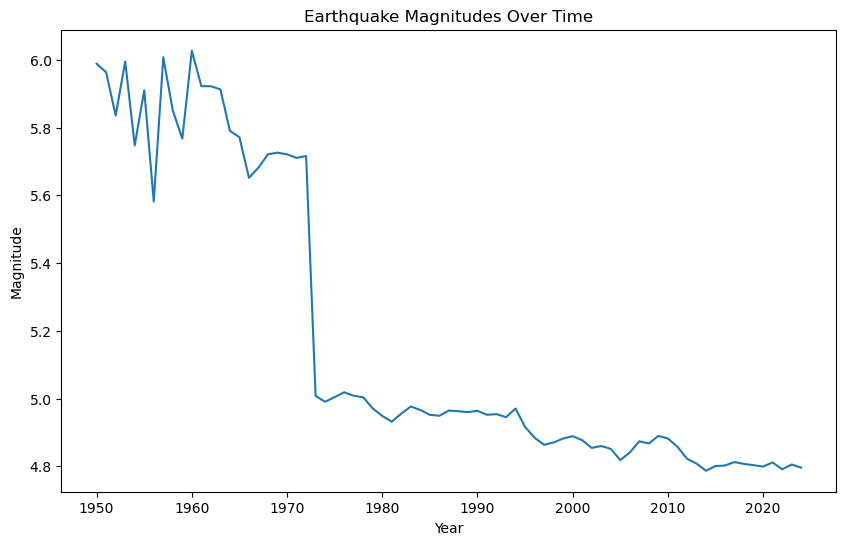

In [23]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load example summary data (replace with your actual dataset)
df = pd.read_csv("processed_data.csv")

# Example: Summary of earthquake magnitudes over time
plt.figure(figsize=(10, 6))
sns.lineplot(data=df, x='year', y='mag', ci=None)
plt.title("Earthquake Magnitudes Over Time")
plt.xlabel("Year")
plt.ylabel("Magnitude")
plt.savefig("earthquake_trends.png")  # Save plot as a PNG file
plt.show()


## 2. Export Key Insights as CSV 

In [24]:
# Example: Summarize data by year
df_summary = df.groupby('year').agg({'mag': ['mean', 'max', 'min', 'count']}).reset_index()
df_summary.columns = ['Year', 'Mean Magnitude', 'Max Magnitude', 'Min Magnitude', 'Count']

# Save the summary to a CSV file
df_summary.to_csv("summary_report.csv", index=False)
print("Summary report saved as 'summary_report.csv'")


Summary report saved as 'summary_report.csv'


## 3. Export Key Insights as Excel

In [25]:
# Save the summary to an Excel file
df_summary.to_excel("summary_report.xlsx", index=False)
print("Summary report saved as 'summary_report.xlsx'")


Summary report saved as 'summary_report.xlsx'


## 4. Automate Reporting in a PDF

In [26]:
from matplotlib.backends.backend_pdf import PdfPages

# Create a PDF to save multiple plots
with PdfPages('earthquake_report.pdf') as pdf:
    # Plot 1: Magnitudes over time
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=df, x='year', y='mag', ci=None)
    plt.title("Earthquake Magnitudes Over Time")
    plt.xlabel("Year")
    plt.ylabel("Magnitude")
    pdf.savefig()  # Save this plot to the PDF
    plt.close()

    # Plot 2: Histogram of magnitudes
    plt.figure(figsize=(10, 6))
    sns.histplot(df['mag'], bins=20, kde=True, color='skyblue')
    plt.title("Histogram of Earthquake Magnitudes")
    plt.xlabel("Magnitude")
    plt.ylabel("Frequency")
    pdf.savefig()  # Save this plot to the PDF
    plt.close()

print("Earthquake report saved as 'earthquake_report.pdf'")


C:\Users\Ashik\AppData\Local\Temp\ipykernel_14692\3675771660.py:7: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(data=df, x='year', y='mag', ci=None)


Earthquake report saved as 'earthquake_report.pdf'


# Extra

2024-12-04 11:57:27.890 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:28.598 
  command:

    streamlit run C:\Users\Ashik\anaconda3\Lib\site-packages\ipykernel_launcher.py [ARGUMENTS]
2024-12-04 11:57:28.598 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:28.598 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:28.598 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:28.598 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:28.613 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:28.613 Thread 'MainThread': mi

2024-12-04 11:57:29.077 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:29.078 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:29.079 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:29.080 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:29.081 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-12-04 11:57:29.081 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


Done


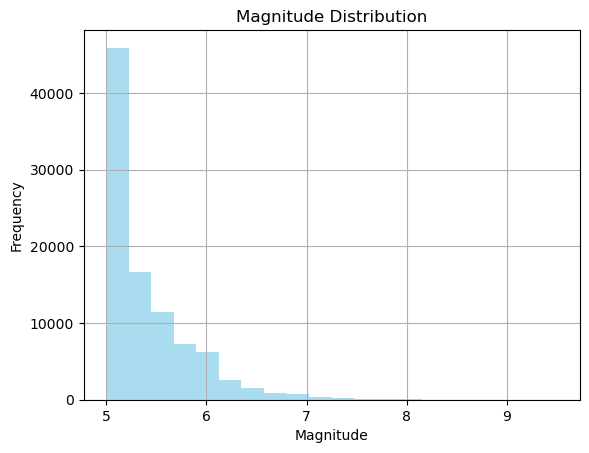

In [43]:
import streamlit as st
import pandas as pd
import matplotlib.pyplot as plt
import joblib

# Load your model and data
model = joblib.load('earthquake_model.pkl')  # Ensure the model is saved in the current directory
data = pd.read_csv('processed_data magType.csv')     # Replace with your dataset file

# Title and Description
st.title("Earthquake Dashboard")
st.markdown("""
This dashboard provides visualizations and predictions for earthquakes based on historical data.
""")

# Display Data
if st.checkbox("Show Raw Data"):
    st.write(data)

# Filter Data
st.sidebar.header("Filter Options")
min_magnitude = st.sidebar.slider("Minimum Magnitude", 0.0, 10.0, 5.0)
filtered_data = data[data['mag'] >= min_magnitude]

st.subheader("Filtered Earthquake Data")
st.write(filtered_data)

# Visualization
st.subheader("Earthquake Magnitude Distribution")
fig, ax = plt.subplots()
filtered_data['mag'].hist(bins=20, alpha=0.7, color='skyblue', ax=ax)
plt.title("Magnitude Distribution")
plt.xlabel("Magnitude")
plt.ylabel("Frequency")
st.pyplot(fig)

# Prediction
st.subheader("Predict Earthquake Magnitude")
latitude = st.number_input("Latitude", value=0.0)
longitude = st.number_input("Longitude", value=0.0)
depth = st.number_input("Depth", value=10.0)
year = st.number_input("Year", value=2023, step=1)
month = st.number_input("Month", value=1, step=1)
day = st.number_input("Day", value=1, step=1)

if st.button("Predict"):
    input_features = pd.DataFrame([{
        'latitude': latitude,
        'longitude': longitude,
        'depth': depth,
        'year': year,
        'month': month,
        'day': day
    }])
    prediction = model.predict(input_features)[0]
    st.success(f"Predicted Magnitude: {prediction}")
print("Done")


In [5]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.express as px
import pandas as pd
import plotly.io as pio
import os

# Set a colorful theme for all graphs
pio.templates.default = "plotly"

# Load data
file_path = 'processed_data magType.csv'
if not os.path.exists(file_path):
    raise FileNotFoundError(f"File not found: {file_path}. Please ensure the file exists in the correct directory.")

df = pd.read_csv(file_path)

# Validate dataset
required_columns = {'year', 'date', 'mag', 'latitude', 'longitude', 'depth'}
if not required_columns.issubset(df.columns):
    raise ValueError(f"The dataset is missing required columns: {required_columns - set(df.columns)}")

# Handle missing or invalid data
df.dropna(subset=required_columns, inplace=True)
df['date'] = pd.to_datetime(df['date'], errors='coerce')  # Ensure dates are valid
df = df.dropna(subset=['date'])  # Drop rows with invalid dates
df['mag'] = df['mag'].apply(lambda x: max(x, 0) if pd.notnull(x) else 0)  # Replace negative or missing magnitudes

# Initialize Dash app
app = dash.Dash(__name__)
app.title = "Earthquake Insights Dashboard"

# Layout
app.layout = html.Div([
    html.H1("Earthquake Trends and Predictions", style={'textAlign': 'center', 'fontSize': '30px', 'color': '#333'}),
    
    # Dropdown for filtering by year
    dcc.Dropdown(
        id='year-filter',
        options=[{'label': year, 'value': year} for year in sorted(df['year'].unique())],
        value=sorted(df['year'].unique())[-1],  # Default: most recent year
        placeholder="Select Year",
        style={'width': '50%', 'margin': '0 auto', 'padding': '10px'}
    ),
    
    # Tabs for displaying graphs
    dcc.Tabs([
        dcc.Tab(label="Magnitude Trends", children=[
            dcc.Graph(id='magnitude-trend-graph')
        ]),
        dcc.Tab(label="Seismic Activity Map", children=[
            dcc.Graph(id='seismic-activity-map')
        ]),
        dcc.Tab(label="Geospatial Heatmap", children=[
            dcc.Graph(id='geospatial-heatmap')
        ]),
        dcc.Tab(label="Magnitude vs Depth", children=[
            dcc.Graph(id='magnitude-depth-plot')
        ]),
    ], style={'padding': '20px'}),
], style={'fontFamily': 'Arial', 'backgroundColor': '#f9f9f9', 'padding': '20px'})

# Callbacks for interactivity
@app.callback(
    [Output('magnitude-trend-graph', 'figure'),
     Output('seismic-activity-map', 'figure'),
     Output('geospatial-heatmap', 'figure'),
     Output('magnitude-depth-plot', 'figure')],
    [Input('year-filter', 'value')]
)
def update_graphs(selected_year):
    # Filter data based on selected year
    filtered_data = df[df['year'] == selected_year] if selected_year else df

    if filtered_data.empty:
        empty_fig = px.line(title="No Data Available")
        return empty_fig, empty_fig, empty_fig, empty_fig
    
    # Line chart for magnitude trends
    trend_fig = px.line(
        filtered_data,
        x='date',
        y='mag',
        title=f'Magnitude Trends for {selected_year}',
        labels={'date': 'Date', 'mag': 'Magnitude'},
        template='plotly'
    )
    
    # Scatter map for seismic activity
    map_fig = px.scatter_geo(
        filtered_data,
        lat='latitude',
        lon='longitude',
        color='mag',
        size='mag',
        title=f'Seismic Activity Map for {selected_year}',
        projection='natural earth',
        template='plotly'
    )
    
    # Geospatial heatmap using Plotly density map
    heatmap_fig = px.density_mapbox(
        filtered_data,
        lat='latitude',
        lon='longitude',
        z='mag',
        radius=10,
        center=dict(lat=filtered_data['latitude'].mean(), lon=filtered_data['longitude'].mean()),
        mapbox_style="carto-positron",
        title=f'Geospatial Heatmap of Earthquakes ({selected_year})'
    )
    
    # Scatterplot and regression line for magnitude vs. depth
    scatter_fig = px.scatter(
        filtered_data,
        x='depth',
        y='mag',
        trendline='ols',  # Add regression line
        title=f'Magnitude vs Depth ({selected_year})',
        labels={'depth': 'Depth (km)', 'mag': 'Magnitude'},
        template='plotly'
    )
    
    return trend_fig, map_fig, heatmap_fig, scatter_fig

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True)


In [1]:
# Install necessary packages if not already installed
# pip install dash plotly pandas

import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.express as px
import pandas as pd
import plotly.io as pio

# Set a colorful theme for all graphs
pio.templates.default = "plotly"  # Can also try "seaborn" for a different look

# Load data
file_path = 'processed_data magType.csv'
df = pd.read_csv(file_path)

# Ensure `df` contains predictions and trends
data = df

# Ensure the dataset has required columns
required_columns = {'year', 'date', 'mag', 'latitude', 'longitude', 'depth'}
if not required_columns.issubset(data.columns):
    raise ValueError(f"The dataset is missing required columns: {required_columns - set(data.columns)}")

# Initialize Dash app
app = dash.Dash(__name__)
app.title = "Earthquake Insights Dashboard"

# Layout
app.layout = html.Div([
    html.H1("Earthquake Trends and Predictions", style={'textAlign': 'center', 'fontSize': '30px', 'color': '#333'}),
    
    # Dropdown for filtering by year
    dcc.Dropdown(
        id='year-filter',
        options=[{'label': year, 'value': year} for year in sorted(data['year'].unique())],
        value=2024,  # Default value set to 2024
        placeholder="Select Year",
        style={'width': '50%', 'margin': '0 auto', 'padding': '10px'}
    ),

    # Summary Statistics
    html.Div([
        html.Div(id='total-count', style={'fontSize': '20px', 'padding': '10px'}),
        html.Div(id='magnitude-range', style={'fontSize': '20px', 'padding': '10px'}),
        html.Div(id='depth-range', style={'fontSize': '20px', 'padding': '10px'}),
    ], style={'textAlign': 'center', 'padding': '20px'}),

    # Graph for magnitude trends
    html.Div([
        dcc.Graph(id='magnitude-trend-graph'),
    ], style={'padding': '20px'}),

    # Scatter map for geospatial data
    html.Div([
        dcc.Graph(id='seismic-activity-map'),
    ], style={'padding': '20px'}),
], style={'fontFamily': 'Arial', 'backgroundColor': '#f9f9f9', 'padding': '20px'})

# Callbacks for interactivity
@app.callback(
    [
        Output('total-count', 'children'),
        Output('magnitude-range', 'children'),
        Output('depth-range', 'children'),
        Output('magnitude-trend-graph', 'figure'),
        Output('seismic-activity-map', 'figure')
    ],
    [Input('year-filter', 'value')]
)
def update_dashboard(selected_year):
    # Filter data based on selected year
    filtered_data = data[data['year'] == selected_year] if selected_year else data
    
    # Summary statistics
    total_count = f"Total Earthquakes: {filtered_data.shape[0]}"
    magnitude_range = f"Magnitude Range: {filtered_data['mag'].min()} - {filtered_data['mag'].max()}"
    depth_range = f"Depth Range: {filtered_data['depth'].min()} km - {filtered_data['depth'].max()} km"
    
    # Line chart for magnitude trends
    trend_fig = px.line(
        filtered_data,
        x='date',
        y='mag',
        title=f'Magnitude Trends for {selected_year}',
        labels={'date': 'Date', 'mag': 'Magnitude'},
        template='plotly'  # Colorful theme
    )
    
    # Scatter map for seismic activity
    map_fig = px.scatter_geo(
        filtered_data,
        lat='latitude',
        lon='longitude',
        color='mag',
        size='mag',
        title=f'Seismic Activity Map for {selected_year}',
        projection='natural earth',
        template='plotly'  # Colorful theme
    )
    
    return total_count, magnitude_range, depth_range, trend_fig, map_fig

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True)


In [6]:
# Install necessary packages if not already installed
# pip install dash plotly pandas

import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.express as px
import pandas as pd
import plotly.io as pio

# Set a colorful theme for all graphs
pio.templates.default = "plotly"  # Can also try "seaborn" for a different look

# Load data
file_path = 'processed_data magType.csv'
df = pd.read_csv(file_path)

# Ensure `df` contains predictions and trends
data = df

# Ensure the dataset has required columns
required_columns = {'year', 'date', 'mag', 'latitude', 'longitude', 'depth', 'month'}
if not required_columns.issubset(data.columns):
    raise ValueError(f"The dataset is missing required columns: {required_columns - set(data.columns)}")

# Initialize Dash app
app = dash.Dash(__name__)
app.title = "Earthquake Insights Dashboard"

# Layout
app.layout = html.Div([
    html.H1("Earthquake Trends and Predictions", style={'textAlign': 'center', 'fontSize': '30px', 'color': '#333'}),
    
    # Dropdown for filtering by year
    dcc.Dropdown(
        id='year-filter',
        options=[{'label': year, 'value': year} for year in sorted(data['year'].unique())],
        value=2024,  # Default value set to 2024
        placeholder="Select Year",
        style={'width': '50%', 'margin': '0 auto', 'padding': '10px'}
    ),
    
    # Summary Statistics
    html.Div([
        html.Div(id='total-count', style={'fontSize': '20px', 'padding': '10px'}),
        html.Div(id='magnitude-range', style={'fontSize': '20px', 'padding': '10px'}),
        html.Div(id='depth-range', style={'fontSize': '20px', 'padding': '10px'}),
    ], style={'textAlign': 'center', 'padding': '20px'}),
    
    # Graphs
    html.Div([
        dcc.Graph(id='earthquake-counts-per-month'),
        dcc.Graph(id='geospatial-heatmap'),
        dcc.Graph(id='latitude-distribution'),
        dcc.Graph(id='longitude-distribution'),
        dcc.Graph(id='depth-distribution'),
        dcc.Graph(id='magnitude-distribution'),
        dcc.Graph(id='magnitude-vs-depth'),
    ], style={'padding': '20px'}),
], style={'fontFamily': 'Arial', 'backgroundColor': '#f9f9f9', 'padding': '20px'})

# Callbacks for interactivity
@app.callback(
    [
        Output('total-count', 'children'),
        Output('magnitude-range', 'children'),
        Output('depth-range', 'children'),
        Output('earthquake-counts-per-month', 'figure'),
        Output('geospatial-heatmap', 'figure'),
        Output('latitude-distribution', 'figure'),
        Output('longitude-distribution', 'figure'),
        Output('depth-distribution', 'figure'),
        Output('magnitude-distribution', 'figure'),
        Output('magnitude-vs-depth', 'figure')
    ],
    [Input('year-filter', 'value')]
)
def update_dashboard(selected_year):
    # Filter data based on selected year
    filtered_data = data[data['year'] == selected_year] if selected_year else data
    
    # Summary statistics
    total_count = f"Total Earthquakes: {filtered_data.shape[0]}"
    magnitude_range = f"Magnitude Range: {filtered_data['mag'].min()} - {filtered_data['mag'].max()}"
    depth_range = f"Depth Range: {filtered_data['depth'].min()} km - {filtered_data['depth'].max()} km"
    
    # Earthquake Counts Per Month
    counts_per_month_fig = px.bar(
        filtered_data.groupby('month')['mag'].count().reset_index(),
        x='month',
        y='mag',
        title=f'Earthquake Counts Per Month ({selected_year})',
        labels={'mag': 'Count', 'month': 'Month'},
        template='plotly'
    )
    
    # Geospatial Heatmap
    heatmap_fig = px.density_mapbox(
        filtered_data,
        lat='latitude',
        lon='longitude',
        z='mag',
        radius=10,
        center={"lat": filtered_data['latitude'].mean(), "lon": filtered_data['longitude'].mean()},
        zoom=3,
        mapbox_style="carto-positron",
        title=f'Geospatial Heatmap of Earthquakes ({selected_year})'
    )
    
    # Latitude Distribution
    latitude_fig = px.histogram(
        filtered_data,
        x='latitude',
        title='Distribution of Latitude',
        labels={'latitude': 'Latitude'},
        template='plotly'
    )
    
    # Longitude Distribution
    longitude_fig = px.histogram(
        filtered_data,
        x='longitude',
        title='Distribution of Longitude',
        labels={'longitude': 'Longitude'},
        template='plotly'
    )
    
    # Depth Distribution
    depth_fig = px.histogram(
        filtered_data,
        x='depth',
        title='Distribution of Depth',
        labels={'depth': 'Depth (km)'},
        template='plotly'
    )
    
    # Magnitude Distribution
    magnitude_fig = px.histogram(
        filtered_data,
        x='mag',
        title='Distribution of Magnitude',
        labels={'mag': 'Magnitude'},
        template='plotly'
    )
    
    # Magnitude vs Depth
    magnitude_vs_depth_fig = px.scatter(
        filtered_data,
        x='depth',
        y='mag',
        title='Magnitude vs Depth',
        labels={'depth': 'Depth (km)', 'mag': 'Magnitude'},
        template='plotly',
        color='mag',
        size='mag'
    )
    
    return (
        total_count,
        magnitude_range,
        depth_range,
        counts_per_month_fig,
        heatmap_fig,
        latitude_fig,
        longitude_fig,
        depth_fig,
        magnitude_fig,
        magnitude_vs_depth_fig
    )

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True)


In [1]:
# Install necessary packages if not already installed
# pip install dash plotly pandas

import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.express as px
import pandas as pd
import plotly.io as pio

# Set a colorful theme for all graphs
pio.templates.default = "plotly"  # Can also try "seaborn" for a different look

# Load data
file_path = 'processed_data magType.csv'
df = pd.read_csv(file_path)

# Ensure `df` contains predictions and trends
data = df

# Ensure the dataset has required columns
required_columns = {'year', 'date', 'mag', 'latitude', 'longitude', 'depth', 'month'}
if not required_columns.issubset(data.columns):
    raise ValueError(f"The dataset is missing required columns: {required_columns - set(data.columns)}")

# Initialize Dash app
app = dash.Dash(__name__)
app.title = "Earthquake Insights Dashboard"

# Layout
app.layout = html.Div([
    html.H1("Earthquake Trends and Predictions", style={'textAlign': 'center', 'fontSize': '30px', 'color': '#333'}),
    
    # Dropdown for filtering by year
    dcc.Dropdown(
        id='year-filter',
        options=[{'label': year, 'value': year} for year in sorted(data['year'].unique())],
        value=2024,  # Default value set to 2024
        placeholder="Select Year",
        style={'width': '50%', 'margin': '0 auto', 'padding': '10px'}
    ),
    
    # Summary Statistics
    html.Div([
        html.Div(id='total-count', style={'fontSize': '20px', 'padding': '10px'}),
        html.Div(id='magnitude-range', style={'fontSize': '20px', 'padding': '10px'}),
        html.Div(id='depth-range', style={'fontSize': '20px', 'padding': '10px'}),
    ], style={'textAlign': 'center', 'padding': '20px'}),
    
    # Magnitude Trends and Seismic Activity Map
    html.Div([
        dcc.Graph(id='magnitude-trend-graph'),
        dcc.Graph(id='seismic-activity-map'),
    ], style={'padding': '20px'}),
    
    # Additional Graphs
    html.Div([
        dcc.Graph(id='earthquake-counts-per-month'),
        dcc.Graph(id='geospatial-heatmap'),
        dcc.Graph(id='latitude-distribution'),
        dcc.Graph(id='longitude-distribution'),
        dcc.Graph(id='depth-distribution'),
        dcc.Graph(id='magnitude-distribution'),
        dcc.Graph(id='magnitude-vs-depth'),
    ], style={'padding': '20px'}),
], style={'fontFamily': 'Arial', 'backgroundColor': '#f9f9f9', 'padding': '20px'})

# Callbacks for interactivity
@app.callback(
    [
        Output('total-count', 'children'),
        Output('magnitude-range', 'children'),
        Output('depth-range', 'children'),
        Output('magnitude-trend-graph', 'figure'),
        Output('seismic-activity-map', 'figure'),
        Output('earthquake-counts-per-month', 'figure'),
        Output('geospatial-heatmap', 'figure'),
        Output('latitude-distribution', 'figure'),
        Output('longitude-distribution', 'figure'),
        Output('depth-distribution', 'figure'),
        Output('magnitude-distribution', 'figure'),
        Output('magnitude-vs-depth', 'figure')
    ],
    [Input('year-filter', 'value')]
)
def update_dashboard(selected_year):
    # Filter data based on selected year
    filtered_data = data[data['year'] == selected_year] if selected_year else data
    
    # Summary statistics
    total_count = f"Total Earthquakes: {filtered_data.shape[0]}"
    magnitude_range = f"Magnitude Range: {filtered_data['mag'].min()} - {filtered_data['mag'].max()}"
    depth_range = f"Depth Range: {filtered_data['depth'].min()} km - {filtered_data['depth'].max()} km"
    
    # Magnitude Trends
    trend_fig = px.line(
        filtered_data,
        x='date',
        y='mag',
        title=f'Magnitude Trends for {selected_year}',
        labels={'date': 'Date', 'mag': 'Magnitude'},
        template='plotly'
    )
    
    # Seismic Activity Map
    seismic_map_fig = px.scatter_geo(
        filtered_data,
        lat='latitude',
        lon='longitude',
        color='mag',
        size='mag',
        title=f'Seismic Activity Map for {selected_year}',
        projection='natural earth',
        template='plotly'
    )
    
    # Earthquake Counts Per Month
    counts_per_month_fig = px.bar(
        filtered_data.groupby('month')['mag'].count().reset_index(),
        x='month',
        y='mag',
        title=f'Earthquake Counts Per Month ({selected_year})',
        labels={'mag': 'Count', 'month': 'Month'},
        template='plotly'
    )
    
    # Geospatial Heatmap
    heatmap_fig = px.density_mapbox(
        filtered_data,
        lat='latitude',
        lon='longitude',
        z='mag',
        radius=10,
        center={"lat": filtered_data['latitude'].mean(), "lon": filtered_data['longitude'].mean()},
        zoom=3,
        mapbox_style="carto-positron",
        title=f'Geospatial Heatmap of Earthquakes ({selected_year})'
    )
    
    # Latitude Distribution
    latitude_fig = px.histogram(
        filtered_data,
        x='latitude',
        title='Distribution of Latitude',
        labels={'latitude': 'Latitude'},
        template='plotly'
    )
    
    # Longitude Distribution
    longitude_fig = px.histogram(
        filtered_data,
        x='longitude',
        title='Distribution of Longitude',
        labels={'longitude': 'Longitude'},
        template='plotly'
    )
    
    # Depth Distribution
    depth_fig = px.histogram(
        filtered_data,
        x='depth',
        title='Distribution of Depth',
        labels={'depth': 'Depth (km)'},
        template='plotly'
    )
    
    # Magnitude Distribution
    magnitude_fig = px.histogram(
        filtered_data,
        x='mag',
        title='Distribution of Magnitude',
        labels={'mag': 'Magnitude'},
        template='plotly'
    )
    
    # Magnitude vs Depth
    magnitude_vs_depth_fig = px.scatter(
        filtered_data,
        x='depth',
        y='mag',
        title='Magnitude vs Depth',
        labels={'depth': 'Depth (km)', 'mag': 'Magnitude'},
        template='plotly',
        color='mag',
        size='mag'
    )
    
    return (
        total_count,
        magnitude_range,
        depth_range,
        trend_fig,
        seismic_map_fig,
        counts_per_month_fig,
        heatmap_fig,
        latitude_fig,
        longitude_fig,
        depth_fig,
        magnitude_fig,
        magnitude_vs_depth_fig
    )

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True)